In [31]:
import numpy as np
import matplotlib.pyplot as plt
import os
import math
import shutil
import glob
from google.colab import drive

In [32]:
import warnings
warnings.filterwarnings('ignore')

In [33]:

drive.mount('/content/gdrive')

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


In [34]:
!unzip '/content/gdrive/MyDrive/Dataset Split/Dataset Distri_80.zip' -d '/content/gdrive/MyDrive/Dataset Split'

Streaming output truncated to the last 5000 lines.
  inflating: /content/gdrive/MyDrive/Dataset Split/Dataset Distri_80/train/Subcortical Dementia/Subcortical Dementia (1796).jpg  
  inflating: /content/gdrive/MyDrive/Dataset Split/Dataset Distri_80/train/Subcortical Dementia/Subcortical Dementia (1797).jpg  
  inflating: /content/gdrive/MyDrive/Dataset Split/Dataset Distri_80/train/Subcortical Dementia/Subcortical Dementia (1798).jpg  
  inflating: /content/gdrive/MyDrive/Dataset Split/Dataset Distri_80/train/Subcortical Dementia/Subcortical Dementia (1799).jpg  
  inflating: /content/gdrive/MyDrive/Dataset Split/Dataset Distri_80/train/Subcortical Dementia/Subcortical Dementia (18).jpg  
  inflating: /content/gdrive/MyDrive/Dataset Split/Dataset Distri_80/train/Subcortical Dementia/Subcortical Dementia (1800).jpg  
  inflating: /content/gdrive/MyDrive/Dataset Split/Dataset Distri_80/train/Subcortical Dementia/Subcortical Dementia (1801).jpg  
  inflating: /content/gdrive/MyDrive/Data

In [35]:
from tensorflow.keras.layers import Input, Lambda, Dense, Flatten
from tensorflow.keras.models import Model
from tensorflow.keras.applications.vgg16 import VGG16
#from tensorflow.keras.applications.vgg19 import VGG19
from tensorflow.keras.preprocessing import image
from tensorflow.keras.preprocessing.image import ImageDataGenerator,load_img
from tensorflow.keras.models import Sequential
import numpy as np
from glob import glob
#import matplotlib.pyplot as plt


In [36]:
IMAGE_SIZE = [224, 224]

train_path = r'/content/gdrive/MyDrive/Dataset Split/Dataset Distri_80/train'
valid_path = r'/content/gdrive/MyDrive/Dataset Split/Dataset Distri_80/Validation'

In [37]:
vgg16 = VGG16(input_shape=IMAGE_SIZE + [3], weights='imagenet', include_top=False)

In [38]:

# don't train existing weights
for layer in vgg16.layers:
    layer.trainable = False

In [39]:
folders = glob(r'/content/gdrive/MyDrive/Dataset Split/Dataset Distri_80/train/*')
folders

['/content/gdrive/MyDrive/Dataset Split/Dataset Distri_80/train/Binswanger Dementia',
 '/content/gdrive/MyDrive/Dataset Split/Dataset Distri_80/train/haemoragic Dementia',
 '/content/gdrive/MyDrive/Dataset Split/Dataset Distri_80/train/Multi-Infract Dementia',
 '/content/gdrive/MyDrive/Dataset Split/Dataset Distri_80/train/Stratigical Dementia',
 '/content/gdrive/MyDrive/Dataset Split/Dataset Distri_80/train/Subcortical Dementia']

In [40]:
len(folders)

5

In [41]:

# our layers - you can add more if you want
x = Flatten()(vgg16.output)

In [42]:
prediction = Dense(len(folders), activation='softmax')(x)

# create a model object
model = Model(inputs=vgg16.input, outputs=prediction)

In [43]:
# view the structure of the model
model.summary()

Model: "model_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         [(None, 224, 224, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 224, 224, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 224, 224, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 112, 112, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 112, 112, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 112, 112, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 56, 56, 128)       0   

In [44]:
import keras.backend as K
def f1_score(y_true, y_pred): #taken from old keras source code
    true_positives = K.sum(K.round(K.clip(y_true * y_pred, 0, 1)))
    possible_positives = K.sum(K.round(K.clip(y_true, 0, 1)))
    predicted_positives = K.sum(K.round(K.clip(y_pred, 0, 1)))
    precision = true_positives / (predicted_positives + K.epsilon())
    recall = true_positives / (possible_positives + K.epsilon())
    f1_val = 2*(precision*recall)/(precision+recall+K.epsilon())
    return f1_val

In [45]:
def specificity(y_true, y_pred):
    neg_y_true = 1 - y_true
    neg_y_pred = 1 - y_pred
    fp = K.sum(neg_y_true * y_pred)
    tn = K.sum(neg_y_true * neg_y_pred)
    specificity = tn / (tn + fp + K.epsilon())
    return specificity

In [46]:
import tensorflow as tf

Metrics=[ 
    tf.keras.metrics.BinaryAccuracy(name='accuracy'),
      tf.keras.metrics.Precision(name='precision'),
      tf.keras.metrics.Recall(name='recall'),  
      tf.keras.metrics.AUC(name='auc'),
      tf.keras.metrics.TrueNegatives(),
      tf.keras.metrics.TruePositives(),
      tf.keras.metrics.FalsePositives(),
      tf.keras.metrics.FalseNegatives(),
      tf.keras.metrics.SensitivityAtSpecificity(0.5),
      tf.keras.metrics.SpecificityAtSensitivity(0.5),
        f1_score,
         specificity,
]

In [47]:
# tell the model what cost and optimization method to use
model.compile(
  loss='categorical_crossentropy',
  optimizer='adam',
  metrics=Metrics
)

In [48]:
# Use the Image Data Generator to import the images from the dataset
from tensorflow.keras.preprocessing.image import ImageDataGenerator

train_datagen = ImageDataGenerator(rescale = 1./255,
                                   shear_range = 0.2,
                                   zoom_range = 0.2,
                                   horizontal_flip = True)

test_datagen = ImageDataGenerator(rescale = 1./255)

In [49]:
# Make sure you provide the same target size as initialied for the image size
training_set = train_datagen.flow_from_directory('/content/gdrive/MyDrive/Dataset Split/Dataset Distri_80/train',
                                                 target_size = (224, 224),
                                                 batch_size = 32,
                                                 class_mode = 'categorical')

Found 17590 images belonging to 5 classes.


In [50]:
test_set = test_datagen.flow_from_directory('/content/gdrive/MyDrive/Dataset Split/Dataset Distri_80/Validation',
                                            target_size = (224, 224),
                                            batch_size = 32,
                                            class_mode = 'categorical')

Found 2190 images belonging to 5 classes.


In [51]:
# fit the model
# Run the cell. It will take some time to execute
r = model.fit_generator(
  training_set,
  validation_data=test_set,
  epochs=20,
  steps_per_epoch=len(training_set),
  validation_steps=len(test_set)
)

Epoch 1/20
550/550 [==============================] - 249s 449ms/step - loss: 1.3745 - accuracy: 0.8161 - precision: 0.5971 - recall: 0.2474 - auc: 0.7466 - true_negatives_1: 67424.0000 - true_positives_1: 4351.0000 - false_positives_1: 2936.0000 - false_negatives_1: 13239.0000 - sensitivity_at_specificity_1: 0.8121 - specificity_at_sensitivity_1: 0.8048 - f1_score: 0.3430 - specificity: 0.8390 - val_loss: 1.0101 - val_accuracy: 0.8553 - val_precision: 0.8573 - val_recall: 0.3320 - val_auc: 0.8644 - val_true_negatives_1: 8639.0000 - val_true_positives_1: 727.0000 - val_false_positives_1: 121.0000 - val_false_negatives_1: 1463.0000 - val_sensitivity_at_specificity_1: 0.9429 - val_specificity_at_sensitivity_1: 0.9414 - val_f1_score: 0.4741 - val_specificity: 0.8624
Epoch 2/20
550/550 [==============================] - 237s 431ms/step - loss: 1.0432 - accuracy: 0.8482 - precision: 0.7266 - recall: 0.3863 - auc: 0.8531 - true_negatives_1: 67803.0000 - true_positives_1: 6795.0000 - false_po

In [52]:
import matplotlib.pyplot as plt


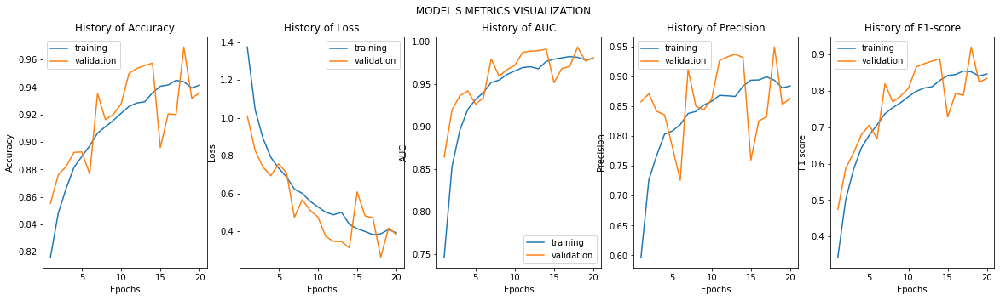

In [53]:
def Train_Val_Plot(acc,val_acc,loss,val_loss,auc,val_auc,precision,val_precision,f1,val_f1):
    
    fig, (ax1, ax2,ax3,ax4,ax5) = plt.subplots(1,5, figsize= (20,5))
    fig.suptitle(" MODEL'S METRICS VISUALIZATION ")

    ax1.plot(range(1, len(acc) + 1), acc)
    ax1.plot(range(1, len(val_acc) + 1), val_acc)
    ax1.set_title('History of Accuracy')
    ax1.set_xlabel('Epochs')
    ax1.set_ylabel('Accuracy')
    ax1.legend(['training', 'validation'])




    ax2.plot(range(1, len(loss) + 1), loss)
    ax2.plot(range(1, len(val_loss) + 1), val_loss)
    ax2.set_title('History of Loss')
    ax2.set_xlabel('Epochs')
    ax2.set_ylabel('Loss')
    ax2.legend(['training', 'validation'])
    
    ax3.plot(range(1, len(auc) + 1), auc)
    ax3.plot(range(1, len(val_auc) + 1), val_auc)
    ax3.set_title('History of AUC')
    ax3.set_xlabel('Epochs')
    ax3.set_ylabel('AUC')
    ax3.legend(['training', 'validation'])
    
    ax4.plot(range(1, len(precision) + 1), precision)
    ax4.plot(range(1, len(val_precision) + 1), val_precision)
    ax4.set_title('History of Precision')
    ax4.set_xlabel('Epochs')
    ax4.set_ylabel('Precision')
    ax4.legend(['training', 'validation'])
    
    ax5.plot(range(1, len(f1) + 1), f1)
    ax5.plot(range(1, len(val_f1) + 1), val_f1)
    ax5.set_title('History of F1-score')
    ax5.set_xlabel('Epochs')
    ax5.set_ylabel('F1 score')
    ax5.legend(['training', 'validation'])

  

    plt.show()
    

Train_Val_Plot(r.history['accuracy'],r.history['val_accuracy'],
               
               r.history['loss'],r.history['val_loss'],
               r.history['auc'],r.history['val_auc'],
               r.history['precision'],r.history['val_precision'],
               r.history['f1_score'],r.history['val_f1_score']
              )

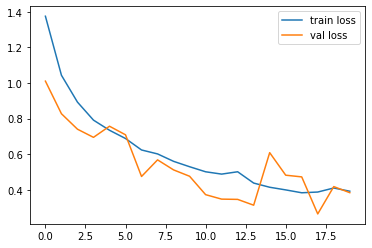

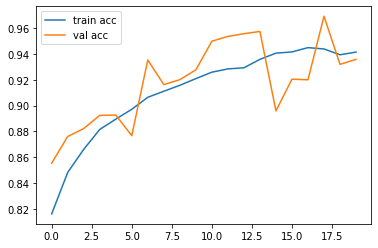

<Figure size 432x288 with 0 Axes>

In [54]:
# plot the loss
plt.plot(r.history['loss'], label='train loss')
plt.plot(r.history['val_loss'], label='val loss')
plt.legend()
plt.show() 

# plot the accuracy
plt.plot(r.history['accuracy'], label='train acc')
plt.plot(r.history['val_accuracy'], label='val acc')
plt.legend()
plt.show()
plt.savefig('AccVal_acc')

In [55]:
# save it as a h5 file


from tensorflow.keras.models import load_model

model.save('model_vgg16_bestmodel_80data.h5')

In [ ]:

y_pred = model.predict(test_set)

In [ ]:
y_pred

array([4, 3, 4, ..., 3, 3, 3])

In [ ]:
from tensorflow.keras.models import load_model
from tensorflow.keras.preprocessing import image

In [ ]:
img=image.load_img('/content/gdrive/MyDrive/Dataset Split/Dataset Distribution/train/Stratigical Dementia/IM-0106-0001.dcm.jpg',target_size=(224,224))

In [ ]:
x=image.img_to_array(img)
x

array([[[0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.],
        ...,
        [0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.]],

       [[0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.],
        ...,
        [0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.]],

       [[0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.],
        ...,
        [0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.]],

       ...,

       [[0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.],
        ...,
        [0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.]],

       [[0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.],
        ...,
        [0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.]],

       [[0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.],
        ...,
        [0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.]]], dtype=float32)

In [ ]:

x.shape

(224, 224, 3)

In [ ]:
x=x/255

In [ ]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator,load_img
import numpy as np
x=np.expand_dims(x,axis=0)
img_data=preprocess_input(x)
img_data.shape

NameError: ignored

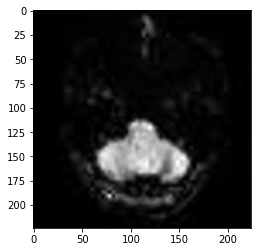

[[0. 1. 0. 0. 0.]]


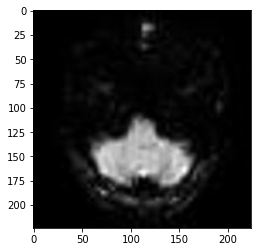

[[0. 1. 0. 0. 0.]]


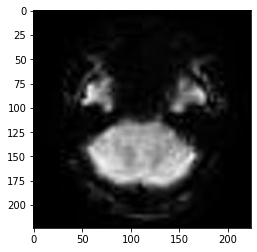

[[0. 0. 0. 1. 0.]]


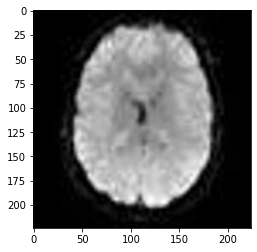

[[0. 0. 0. 1. 0.]]


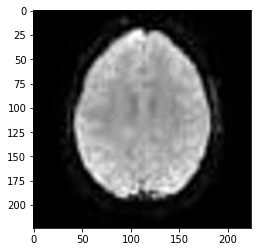

[[1. 0. 0. 0. 0.]]


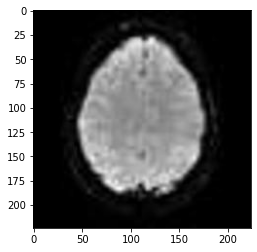

[[2.8464151e-06 0.0000000e+00 0.0000000e+00 9.9999714e-01 0.0000000e+00]]


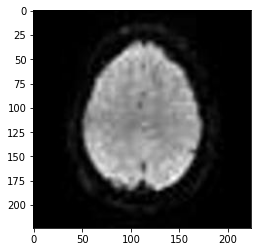

[[0. 1. 0. 0. 0.]]


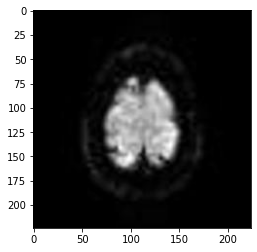

[[0.000000e+00 1.000000e+00 0.000000e+00 0.000000e+00 3.450519e-09]]


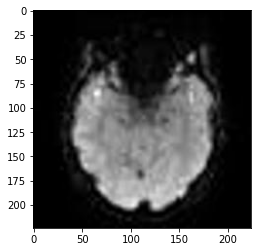

[[0. 0. 1. 0. 0.]]


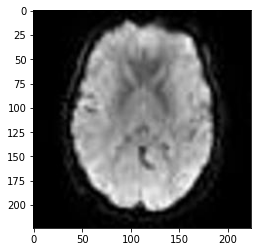

[[8.1932060e-31 1.0000000e+00 0.0000000e+00 3.7334015e-34 1.6746731e-14]]


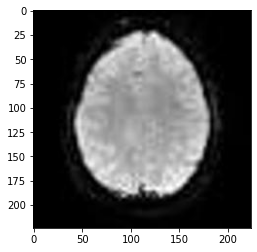

[[1.0000000e+00 0.0000000e+00 0.0000000e+00 1.3134907e-18 0.0000000e+00]]


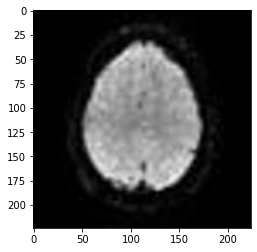

[[4.2353195e-37 1.0000000e+00 0.0000000e+00 1.4215570e-16 0.0000000e+00]]


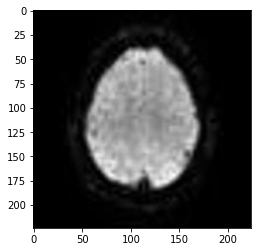

[[0.0000000e+00 1.0000000e+00 0.0000000e+00 2.1805211e-30 0.0000000e+00]]


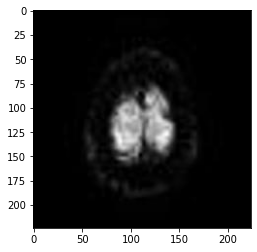

[[0.0000000e+00 1.6960111e-36 0.0000000e+00 0.0000000e+00 1.0000000e+00]]


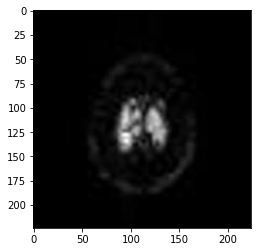

[[0.0000000e+00 1.0000000e+00 0.0000000e+00 0.0000000e+00 1.1530151e-14]]


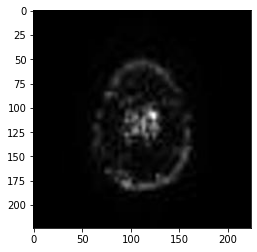

[[0. 1. 0. 0. 0.]]


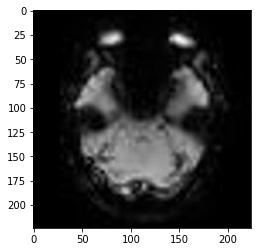

[[0.         0.9828487  0.         0.01715129 0.        ]]


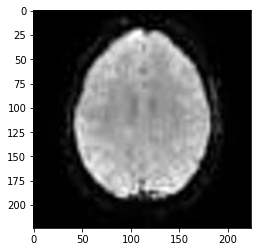

[[1.0000000e+00 0.0000000e+00 0.0000000e+00 2.4124177e-32 0.0000000e+00]]


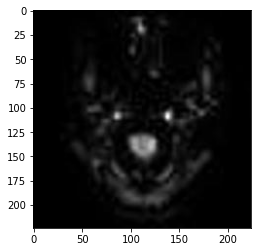

[[0. 0. 0. 1. 0.]]


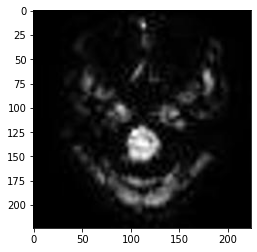

[[0. 0. 0. 1. 0.]]


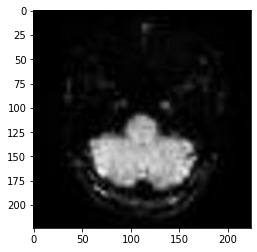

[[0. 1. 0. 0. 0.]]


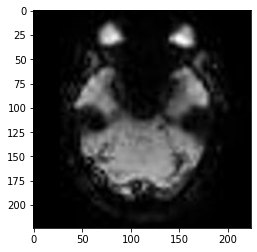

[[0. 1. 0. 0. 0.]]


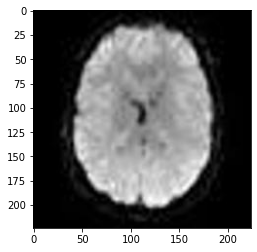

[[2.9274770e-18 4.9332892e-27 0.0000000e+00 1.0000000e+00 8.5698314e-35]]


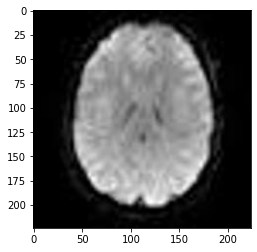

[[1.0000000e+00 1.1815905e-17 0.0000000e+00 1.1450613e-26 0.0000000e+00]]


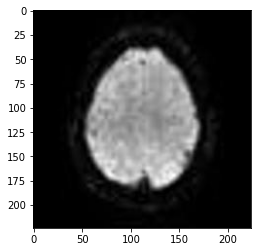

[[0. 1. 0. 0. 0.]]


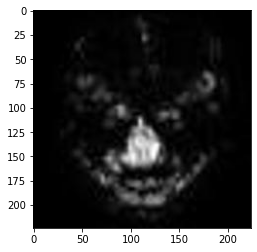

[[0. 1. 0. 0. 0.]]


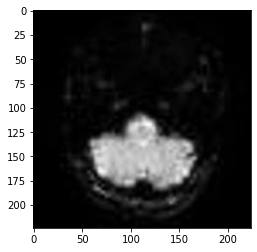

[[0. 1. 0. 0. 0.]]


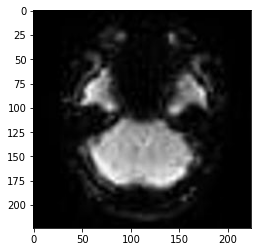

[[0. 0. 0. 1. 0.]]


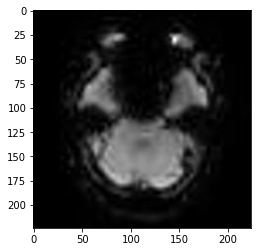

[[0. 1. 0. 0. 0.]]


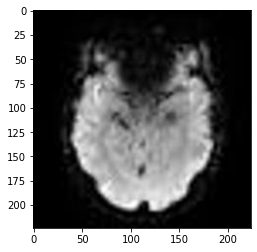

[[0. 1. 0. 0. 0.]]


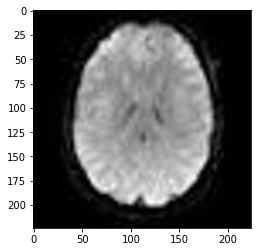

[[1.0000000e+00 0.0000000e+00 0.0000000e+00 1.6958942e-29 0.0000000e+00]]


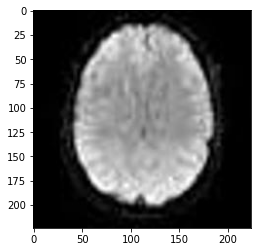

[[0.000000e+00 0.000000e+00 7.324415e-33 1.000000e+00 0.000000e+00]]


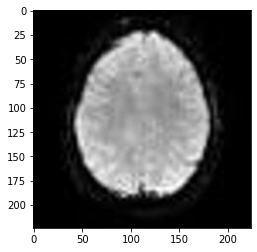

[[1.0000000e+00 6.6939260e-35 0.0000000e+00 1.2802296e-12 0.0000000e+00]]


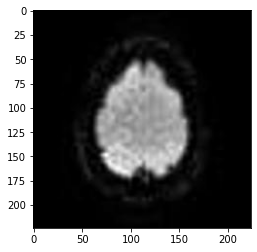

[[0. 1. 0. 0. 0.]]


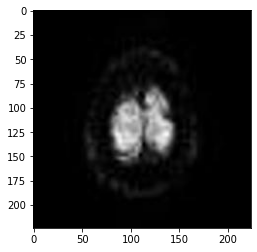

[[0.0000000e+00 4.7899987e-19 0.0000000e+00 0.0000000e+00 1.0000000e+00]]


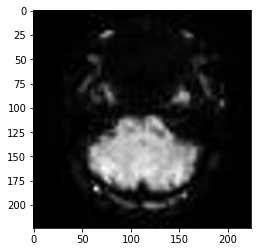

[[0.0000000e+00 1.0000000e+00 0.0000000e+00 3.3550078e-13 0.0000000e+00]]


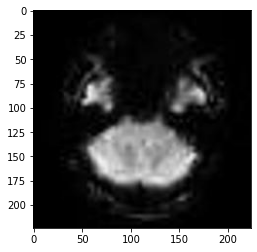

[[0. 0. 0. 1. 0.]]


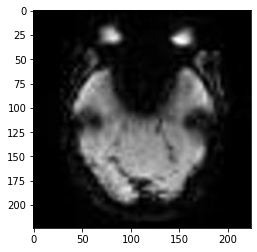

[[0. 0. 0. 1. 0.]]


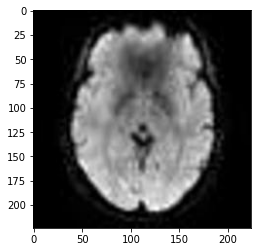

[[0. 0. 0. 1. 0.]]


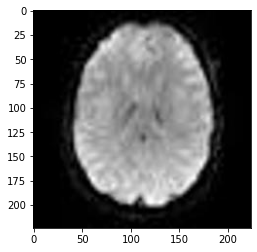

[[1.0000000e+00 2.5218022e-35 0.0000000e+00 2.3190344e-10 0.0000000e+00]]


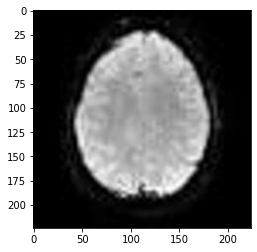

[[1.000000e+00 0.000000e+00 0.000000e+00 3.024195e-20 0.000000e+00]]


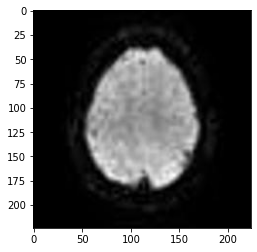

[[0. 1. 0. 0. 0.]]


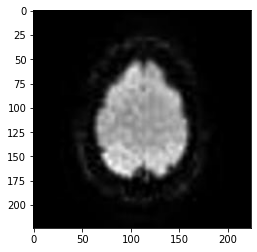

[[0. 1. 0. 0. 0.]]


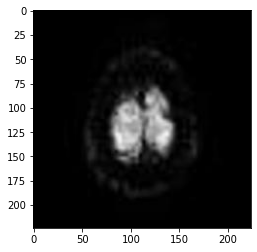

[[0.0000000e+00 1.5381407e-19 0.0000000e+00 0.0000000e+00 1.0000000e+00]]


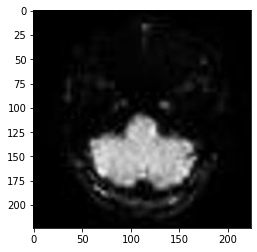

[[0. 1. 0. 0. 0.]]


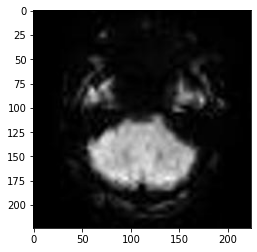

[[0. 0. 0. 1. 0.]]


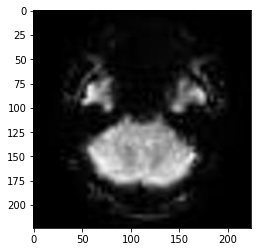

[[0. 0. 0. 1. 0.]]


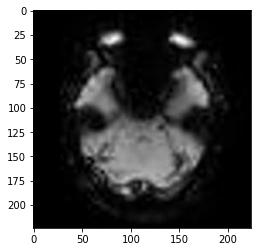

[[0.0000000e+00 1.7257336e-34 0.0000000e+00 1.0000000e+00 0.0000000e+00]]


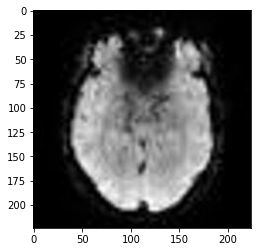

[[0. 0. 0. 1. 0.]]


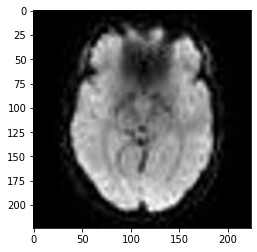

[[0.         0.12290431 0.         0.8770957  0.        ]]


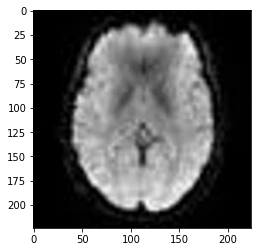

[[0. 0. 0. 1. 0.]]


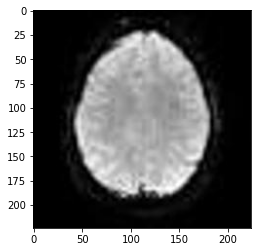

[[1.000000e+00 6.522766e-28 0.000000e+00 0.000000e+00 0.000000e+00]]


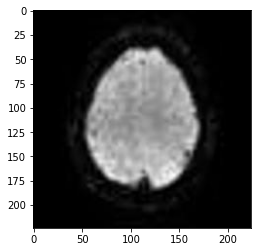

[[0.0000000e+00 1.0000000e+00 0.0000000e+00 4.3482608e-38 0.0000000e+00]]


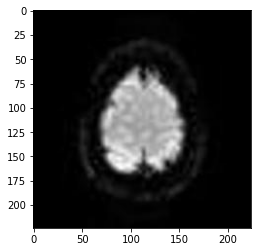

[[0. 1. 0. 0. 0.]]


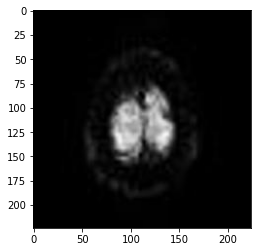

[[0.000000e+00 4.390917e-06 0.000000e+00 0.000000e+00 9.999956e-01]]


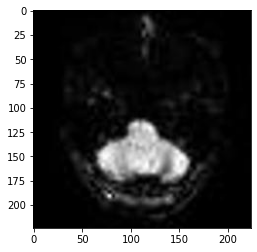

[[0. 1. 0. 0. 0.]]


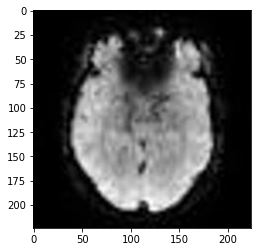

[[0.0000000e+00 2.0841704e-38 1.0000000e+00 1.0296453e-12 0.0000000e+00]]


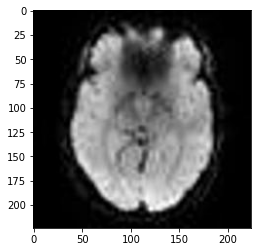

[[0.0000000e+00 1.0000000e+00 0.0000000e+00 6.9047128e-32 1.0933825e-36]]


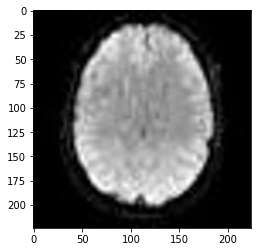

[[0. 0. 0. 1. 0.]]


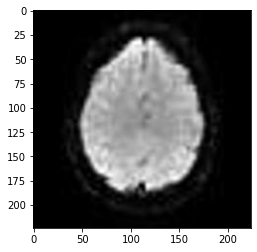

[[0.80329317 0.19670683 0.         0.         0.        ]]


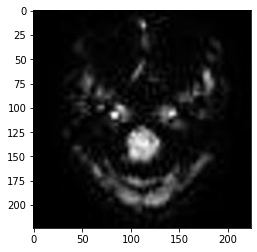

[[0.0000000e+00 1.0000000e+00 0.0000000e+00 2.7690993e-19 0.0000000e+00]]


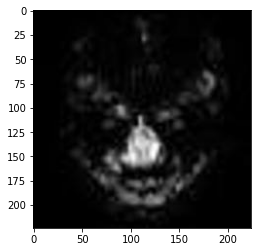

[[0.0000000e+00 1.0000000e+00 0.0000000e+00 4.3939037e-28 0.0000000e+00]]


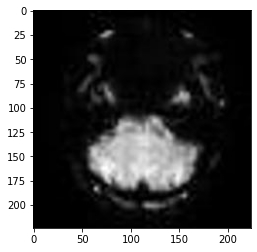

[[0.0000000e+00 1.2695726e-33 0.0000000e+00 1.0000000e+00 0.0000000e+00]]


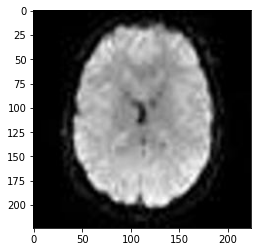

[[1.9876903e-23 1.1370648e-19 0.0000000e+00 1.0000000e+00 0.0000000e+00]]


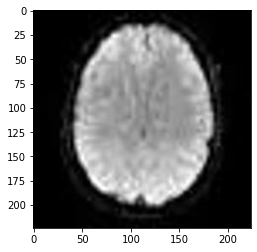

[[0. 0. 0. 1. 0.]]


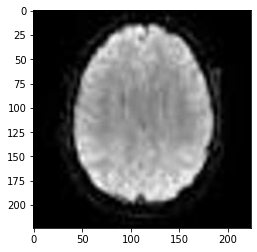

[[0.0000000e+00 1.0000000e+00 0.0000000e+00 1.2249499e-15 0.0000000e+00]]


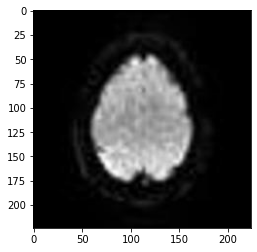

[[0.0000000e+00 2.3650379e-07 0.0000000e+00 0.0000000e+00 9.9999976e-01]]


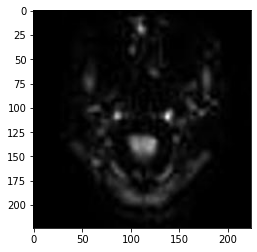

[[0. 1. 0. 0. 0.]]


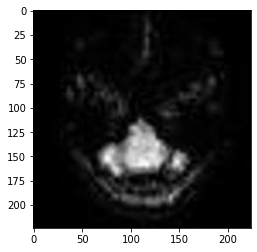

[[0. 1. 0. 0. 0.]]


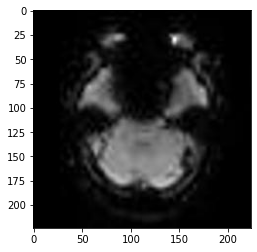

[[0.000000e+00 1.000000e+00 0.000000e+00 4.173125e-30 0.000000e+00]]


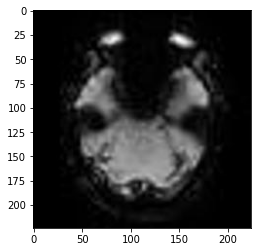

[[0. 1. 0. 0. 0.]]


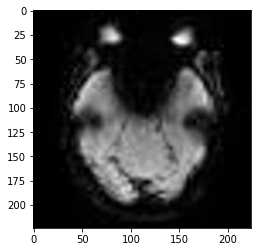

[[6.207527e-04 0.000000e+00 0.000000e+00 9.993793e-01 0.000000e+00]]


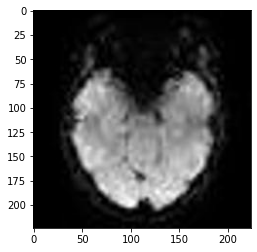

[[0.0000000e+00 3.2376466e-15 0.0000000e+00 1.0000000e+00 0.0000000e+00]]


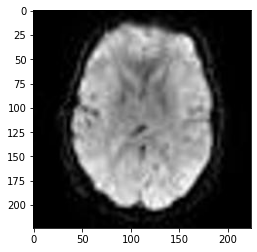

[[0.0000000e+00 1.4183896e-29 0.0000000e+00 1.0000000e+00 0.0000000e+00]]


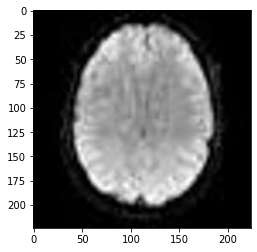

[[2.8581318e-13 0.0000000e+00 1.0240092e-34 1.0000000e+00 0.0000000e+00]]


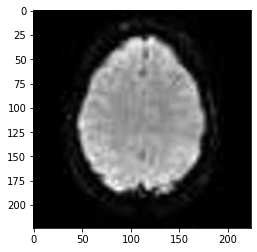

[[3.7393138e-13 0.0000000e+00 0.0000000e+00 1.0000000e+00 0.0000000e+00]]


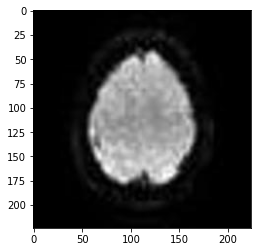

[[2.3641913e-14 1.0000000e+00 0.0000000e+00 0.0000000e+00 3.4845666e-24]]


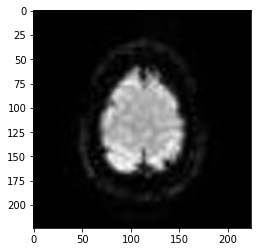

[[0. 1. 0. 0. 0.]]


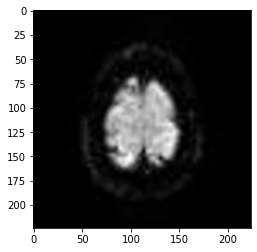

[[0.00000e+00 1.65112e-29 0.00000e+00 0.00000e+00 1.00000e+00]]


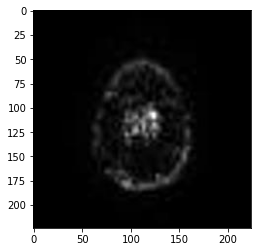

[[0. 1. 0. 0. 0.]]


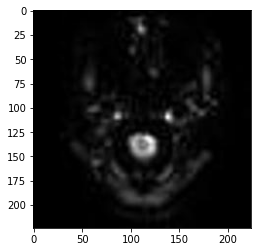

[[0. 0. 0. 1. 0.]]


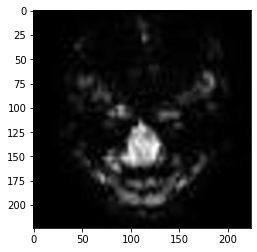

[[0. 1. 0. 0. 0.]]


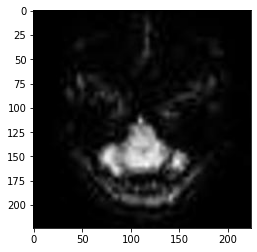

[[0. 1. 0. 0. 0.]]


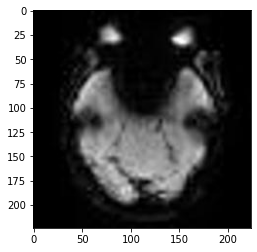

[[1. 0. 0. 0. 0.]]


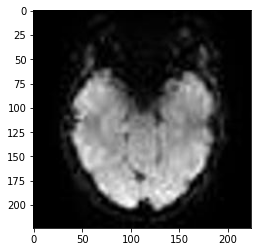

[[0. 0. 0. 1. 0.]]


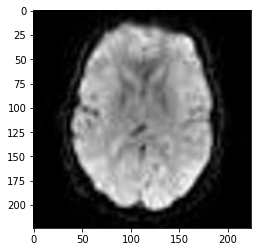

[[0.0000000e+00 0.0000000e+00 4.3700454e-15 1.0000000e+00 0.0000000e+00]]


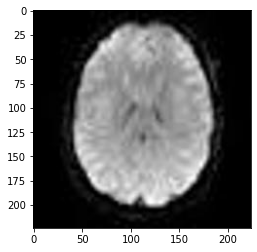

[[0. 0. 0. 1. 0.]]


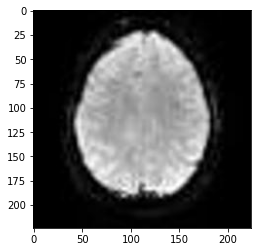

[[1. 0. 0. 0. 0.]]


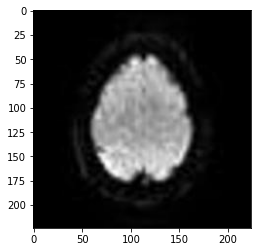

[[0.0000000e+00 1.0000000e+00 0.0000000e+00 0.0000000e+00 5.5318057e-22]]


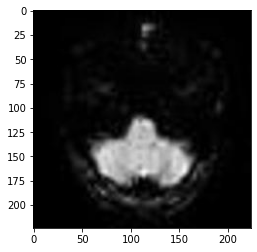

[[0. 1. 0. 0. 0.]]


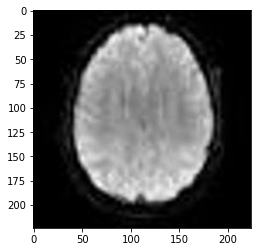

[[0.0000000e+00 1.0000000e+00 0.0000000e+00 1.7661874e-18 0.0000000e+00]]


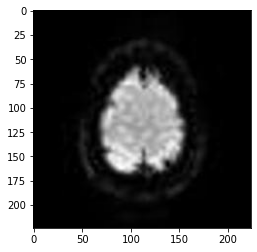

[[0.0000000e+00 1.0000000e+00 0.0000000e+00 0.0000000e+00 1.3457091e-37]]


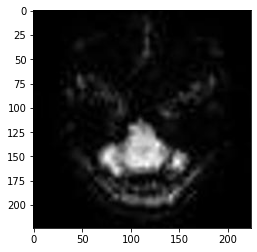

[[0. 1. 0. 0. 0.]]


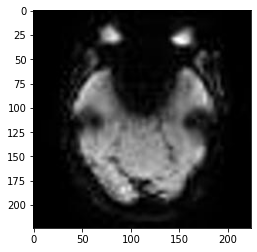

[[1.0000000e+00 0.0000000e+00 0.0000000e+00 2.1464936e-38 0.0000000e+00]]


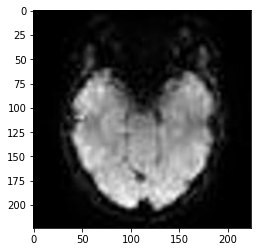

[[0.0000000e+00 9.9999094e-01 0.0000000e+00 9.0798521e-06 0.0000000e+00]]


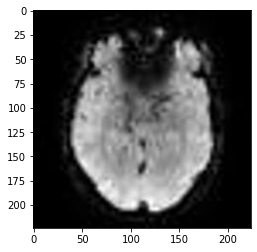

[[0.         0.98093146 0.         0.01906859 0.        ]]


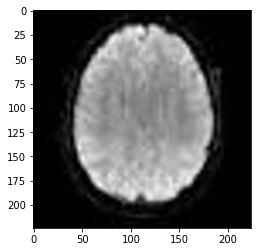

[[0.0000000e+00 1.0000000e+00 0.0000000e+00 2.4183007e-21 0.0000000e+00]]


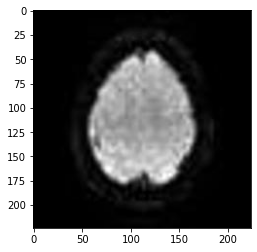

[[1.00000000e+00 1.00478185e-11 0.00000000e+00 0.00000000e+00
  1.60440158e-24]]


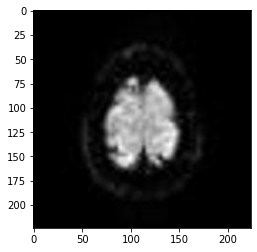

[[0.0000000e+00 2.9386186e-27 0.0000000e+00 0.0000000e+00 1.0000000e+00]]


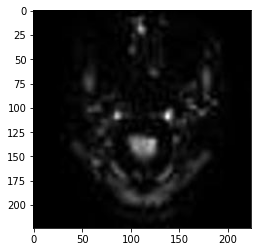

[[0.0000000e+00 5.9790042e-04 0.0000000e+00 9.9940205e-01 0.0000000e+00]]


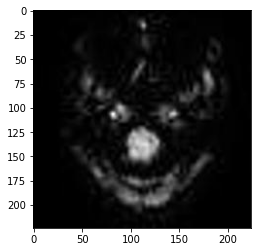

[[0.000000e+00 1.000000e+00 0.000000e+00 6.341755e-17 0.000000e+00]]


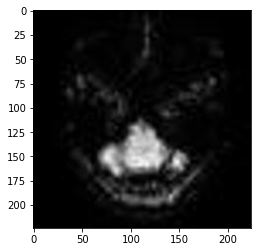

[[0. 1. 0. 0. 0.]]


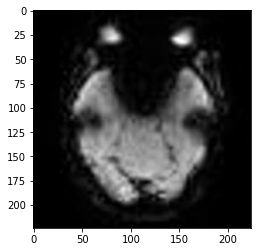

[[1.0824236e-05 0.0000000e+00 0.0000000e+00 9.9998915e-01 0.0000000e+00]]


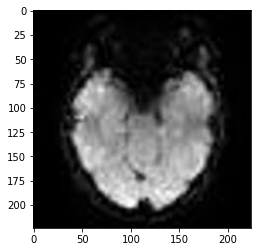

[[0. 0. 0. 1. 0.]]


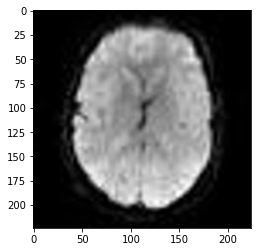

[[0.0000000e+00 9.9622321e-01 0.0000000e+00 3.7767210e-03 1.0404073e-22]]


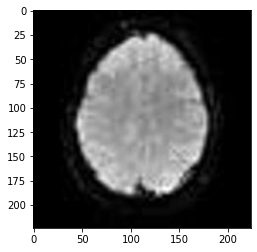

[[1. 0. 0. 0. 0.]]


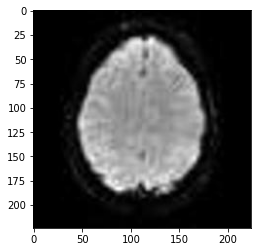

[[7.0543756e-29 1.0000000e+00 0.0000000e+00 1.3052244e-18 0.0000000e+00]]


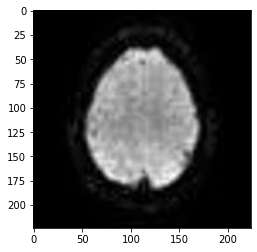

[[0. 1. 0. 0. 0.]]


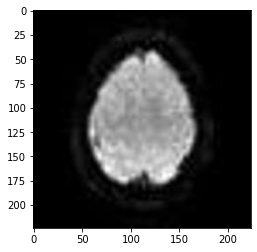

[[4.3867955e-16 1.0000000e+00 0.0000000e+00 0.0000000e+00 4.8479629e-25]]


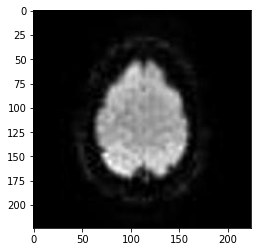

[[0. 1. 0. 0. 0.]]


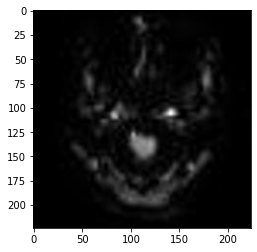

[[0.000000e+00 1.000000e+00 0.000000e+00 4.062054e-28 0.000000e+00]]


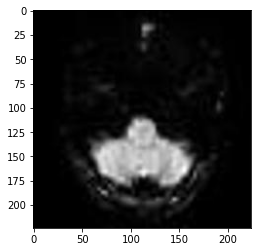

[[0. 1. 0. 0. 0.]]


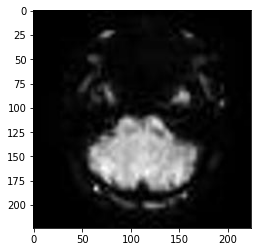

[[0. 1. 0. 0. 0.]]


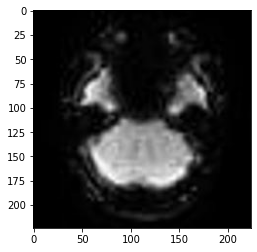

[[0. 0. 0. 1. 0.]]


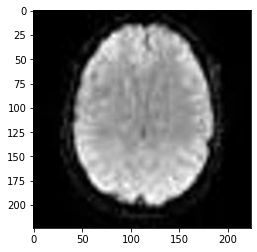

[[0. 0. 0. 1. 0.]]


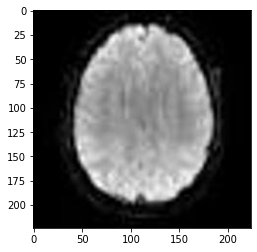

[[0. 1. 0. 0. 0.]]


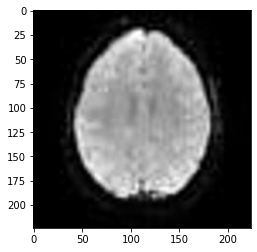

[[1. 0. 0. 0. 0.]]


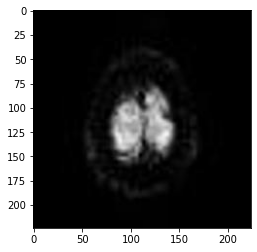

[[0.000000e+00 2.591957e-27 0.000000e+00 0.000000e+00 1.000000e+00]]


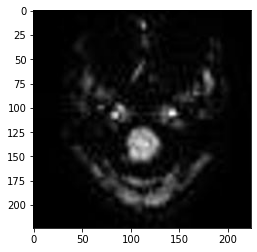

[[0. 0. 0. 1. 0.]]


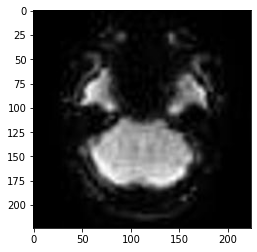

[[0. 0. 0. 1. 0.]]


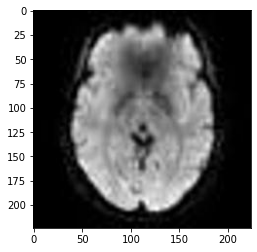

[[0. 0. 0. 1. 0.]]


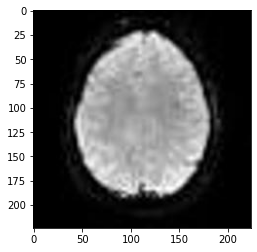

[[1. 0. 0. 0. 0.]]


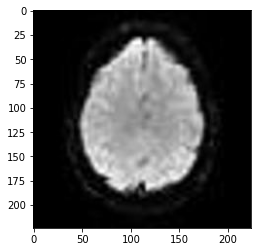

[[9.9980384e-01 1.9618303e-04 0.0000000e+00 0.0000000e+00 0.0000000e+00]]


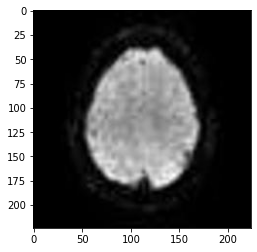

[[0.000000e+00 1.000000e+00 0.000000e+00 2.794958e-22 0.000000e+00]]


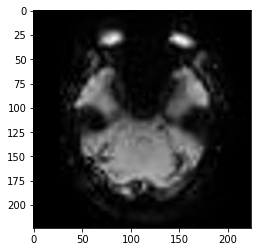

[[0.0000000e+00 7.5590194e-11 0.0000000e+00 1.0000000e+00 0.0000000e+00]]


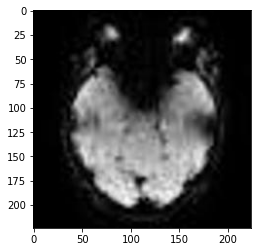

[[1.0992165e-01 8.9002711e-01 0.0000000e+00 5.1298739e-05 0.0000000e+00]]


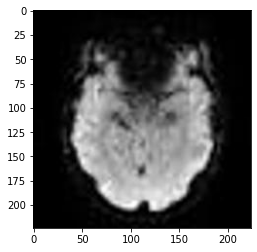

[[0.0000000e+00 1.8778278e-11 1.0000000e+00 0.0000000e+00 0.0000000e+00]]


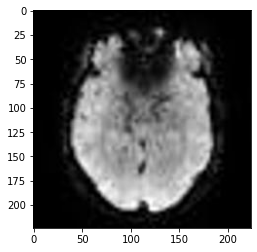

[[0.0000000e+00 1.0062112e-36 1.2573885e-10 4.8810194e-22 1.0000000e+00]]


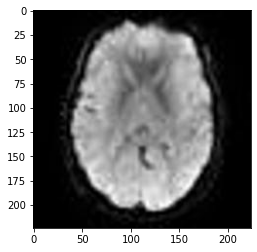

[[0.000000e+00 1.000000e+00 0.000000e+00 2.791502e-32 0.000000e+00]]


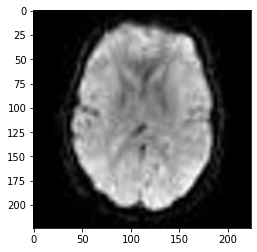

[[0.0000000e+00 2.1267472e-21 0.0000000e+00 1.0000000e+00 0.0000000e+00]]


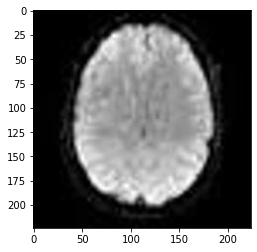

[[3.7382023e-35 0.0000000e+00 0.0000000e+00 1.0000000e+00 0.0000000e+00]]


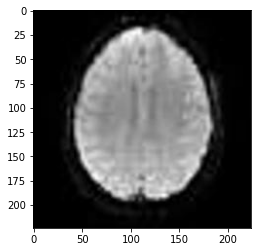

[[1. 0. 0. 0. 0.]]


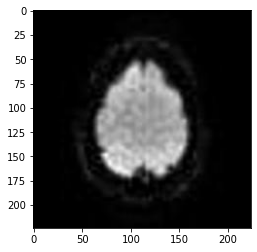

[[0. 1. 0. 0. 0.]]


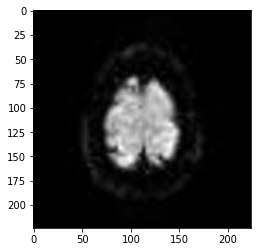

[[0. 0. 0. 0. 1.]]


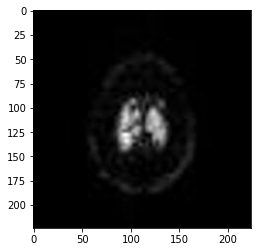

[[0.0000000e+00 9.9999928e-01 0.0000000e+00 1.9865089e-28 6.6323025e-07]]


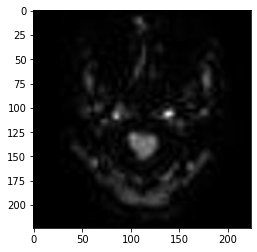

[[0. 0. 0. 1. 0.]]


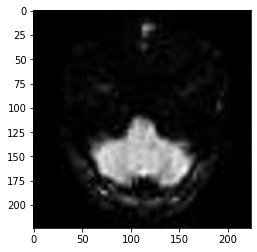

[[0. 1. 0. 0. 0.]]


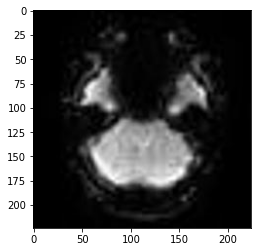

[[0. 0. 0. 1. 0.]]


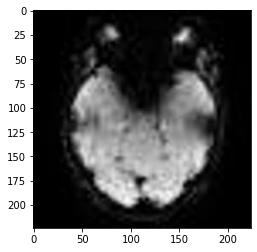

[[0.0000000e+00 1.0587242e-29 0.0000000e+00 1.0000000e+00 0.0000000e+00]]


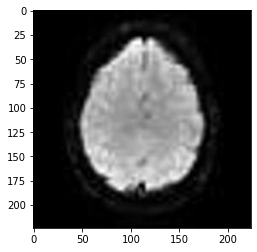

[[3.2992892e-14 1.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00]]


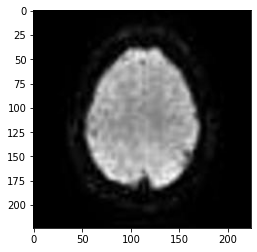

[[0.0000000e+00 1.0000000e+00 0.0000000e+00 4.2197415e-37 0.0000000e+00]]


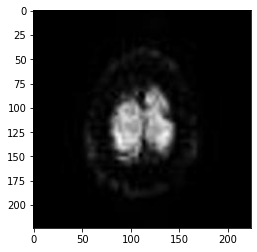

[[0. 0. 0. 0. 1.]]


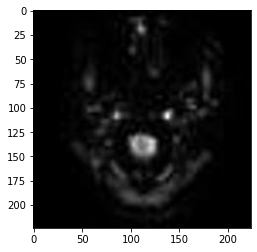

[[0. 0. 0. 1. 0.]]


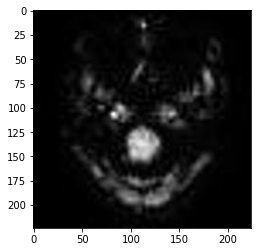

[[0. 1. 0. 0. 0.]]


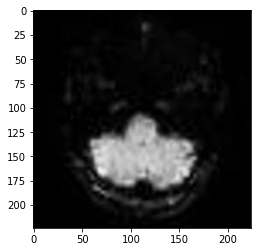

[[0. 1. 0. 0. 0.]]


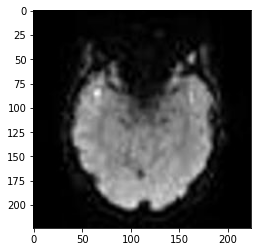

[[0.000000e+00 0.000000e+00 1.000000e+00 4.121723e-15 0.000000e+00]]


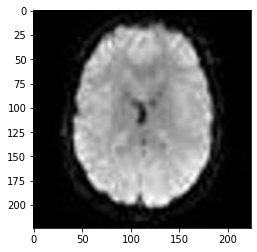

[[4.6744262e-06 5.1471432e-08 0.0000000e+00 1.8065598e-18 9.9999523e-01]]


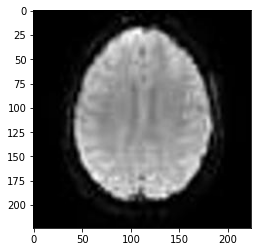

[[9.9986196e-01 1.7444092e-13 0.0000000e+00 1.3804475e-04 0.0000000e+00]]


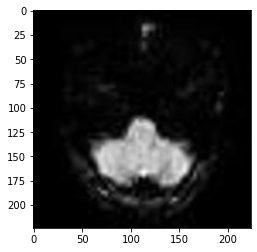

[[0. 1. 0. 0. 0.]]


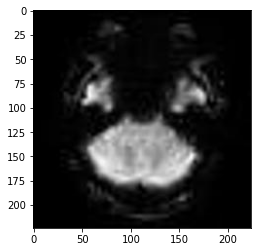

[[0. 0. 0. 1. 0.]]


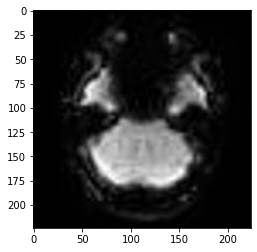

[[0. 0. 0. 1. 0.]]


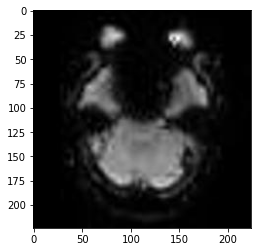

[[0. 1. 0. 0. 0.]]


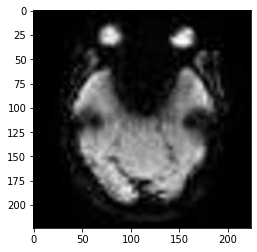

[[1. 0. 0. 0. 0.]]


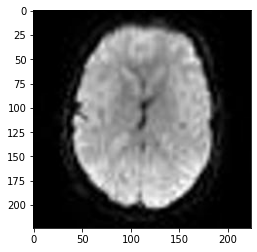

[[0. 1. 0. 0. 0.]]


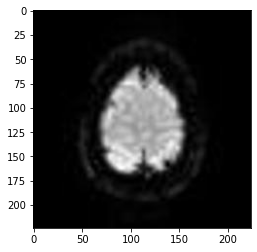

[[0. 1. 0. 0. 0.]]


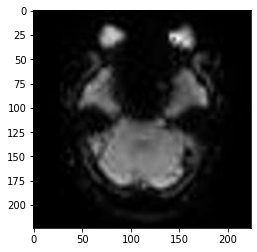

[[0. 1. 0. 0. 0.]]


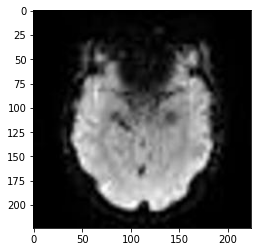

[[0. 0. 1. 0. 0.]]


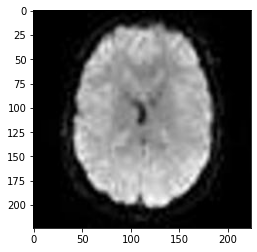

[[9.3463176e-01 6.5366112e-02 0.0000000e+00 2.1590140e-06 2.2178898e-37]]


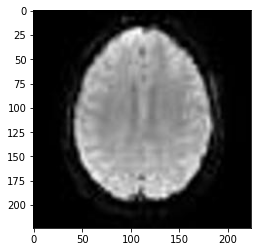

[[5.6669056e-09 0.0000000e+00 0.0000000e+00 1.0000000e+00 0.0000000e+00]]


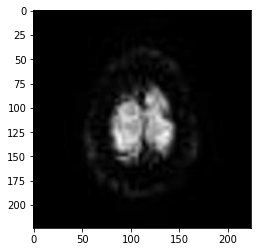

[[0. 0. 0. 0. 1.]]


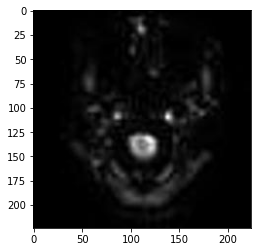

[[0.0000000e+00 0.0000000e+00 0.0000000e+00 1.0000000e+00 2.8341553e-08]]


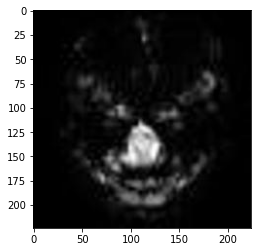

[[0. 1. 0. 0. 0.]]


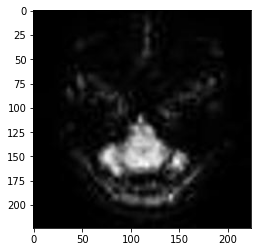

[[0. 1. 0. 0. 0.]]


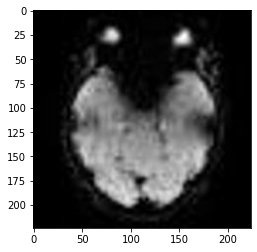

[[0. 1. 0. 0. 0.]]


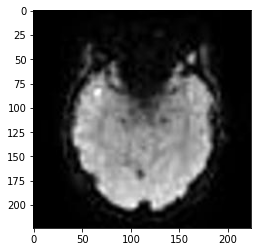

[[0.0000000e+00 0.0000000e+00 1.0000000e+00 4.5712575e-27 0.0000000e+00]]


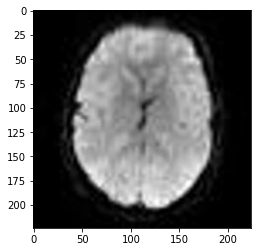

[[3.2966530e-35 9.8092490e-01 0.0000000e+00 3.2864073e-35 1.9075081e-02]]


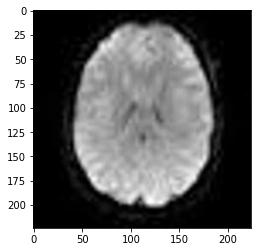

[[9.9867237e-01 2.8411019e-08 0.0000000e+00 1.3276043e-03 0.0000000e+00]]


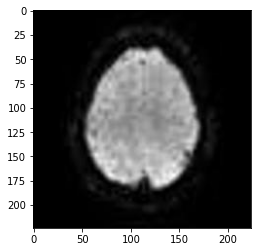

[[1.0000000e+00 2.9500191e-08 0.0000000e+00 1.3792462e-11 0.0000000e+00]]


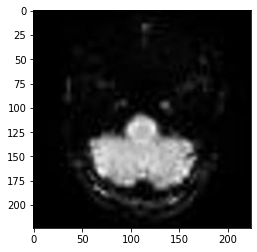

[[0. 1. 0. 0. 0.]]


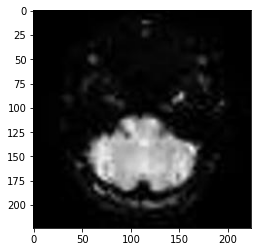

[[0. 1. 0. 0. 0.]]


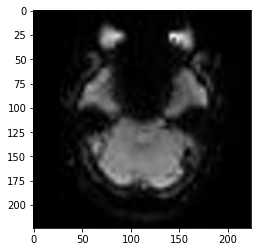

[[0.0000000e+00 1.0000000e+00 0.0000000e+00 3.5943376e-19 0.0000000e+00]]


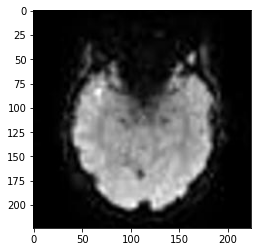

[[0. 0. 0. 1. 0.]]


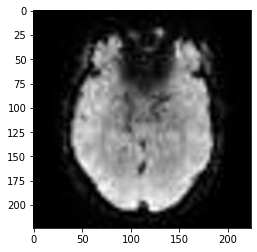

[[0.000000e+00 0.000000e+00 1.461106e-20 1.000000e+00 0.000000e+00]]


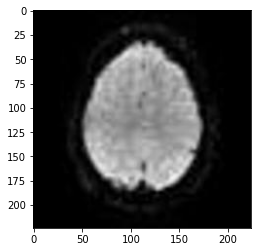

[[0. 1. 0. 0. 0.]]


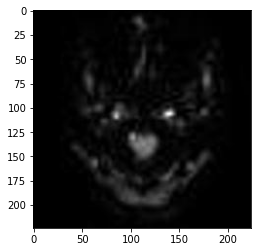

[[0. 0. 0. 1. 0.]]


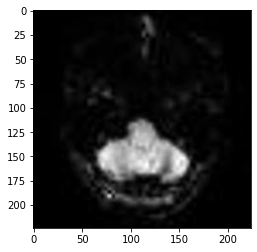

[[0. 1. 0. 0. 0.]]


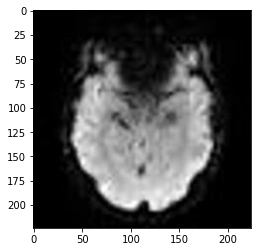

[[0. 1. 0. 0. 0.]]


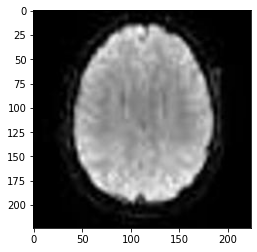

[[0. 1. 0. 0. 0.]]


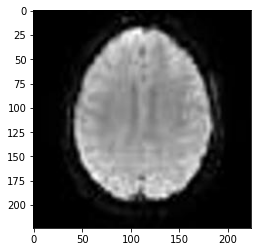

[[0.3124839 0.        0.        0.6875161 0.       ]]


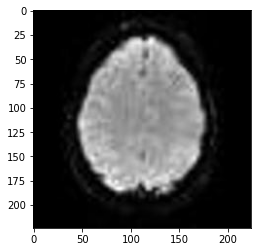

[[1.000000e+00 0.000000e+00 0.000000e+00 1.327632e-09 0.000000e+00]]


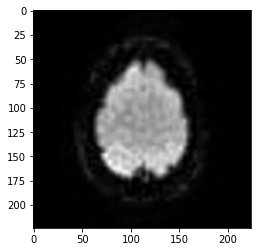

[[0.000000e+00 1.000000e+00 0.000000e+00 0.000000e+00 8.015815e-31]]


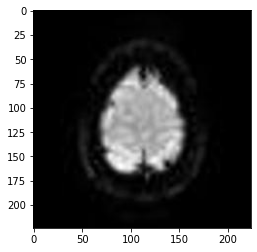

[[0. 1. 0. 0. 0.]]


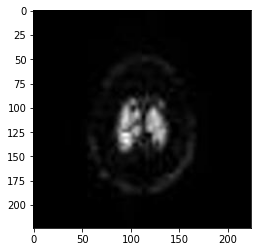

[[0.0000000e+00 1.0000000e+00 0.0000000e+00 0.0000000e+00 1.7995354e-22]]


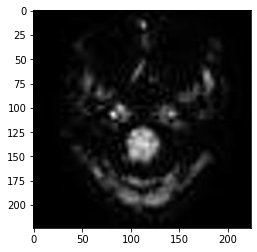

[[0.0000000e+00 3.4996116e-04 0.0000000e+00 9.9965000e-01 0.0000000e+00]]


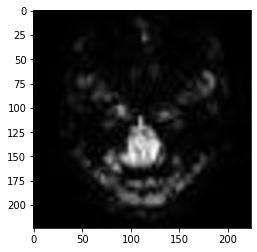

[[0. 1. 0. 0. 0.]]


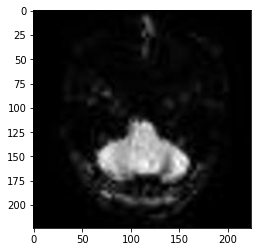

[[1.2021187e-38 1.0000000e+00 0.0000000e+00 5.9454583e-29 0.0000000e+00]]


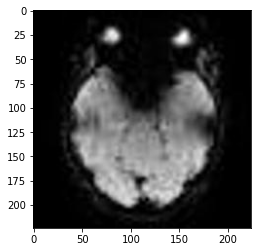

[[9.9962115e-01 2.4246552e-34 0.0000000e+00 3.7877797e-04 0.0000000e+00]]


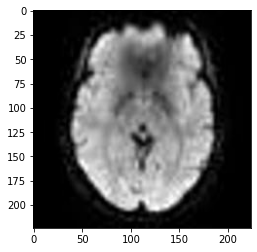

[[0. 0. 0. 1. 0.]]


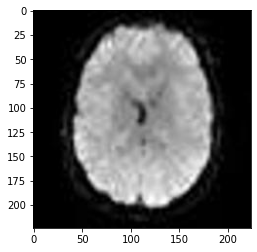

[[6.3356308e-34 1.2244092e-13 0.0000000e+00 1.0000000e+00 0.0000000e+00]]


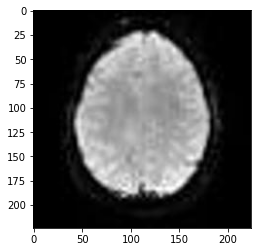

[[1. 0. 0. 0. 0.]]


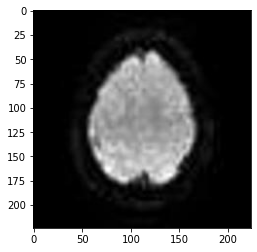

[[1.2535427e-25 1.0000000e+00 0.0000000e+00 0.0000000e+00 2.1025653e-19]]


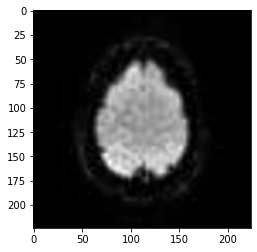

[[0. 1. 0. 0. 0.]]


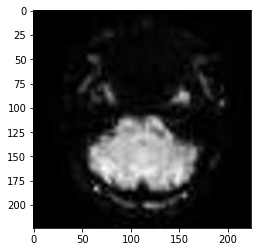

[[0. 1. 0. 0. 0.]]


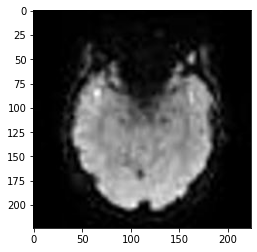

[[0.000000e+00 0.000000e+00 9.999999e-01 8.953349e-08 0.000000e+00]]


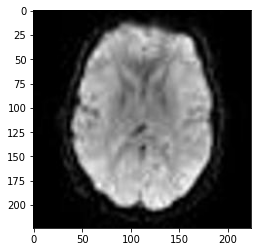

[[0.0000000e+00 9.9999046e-01 0.0000000e+00 9.5097375e-06 0.0000000e+00]]


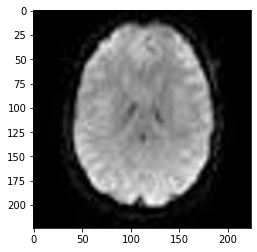

[[1.1289420e-22 1.0000000e+00 0.0000000e+00 6.8417124e-31 0.0000000e+00]]


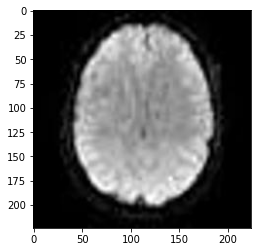

[[0. 0. 0. 1. 0.]]


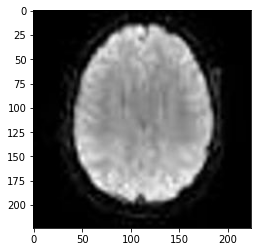

[[0. 1. 0. 0. 0.]]


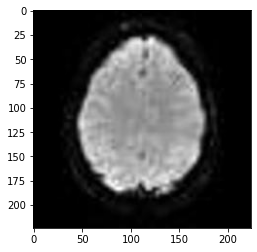

[[9.295958e-23 9.905471e-22 0.000000e+00 1.000000e+00 0.000000e+00]]


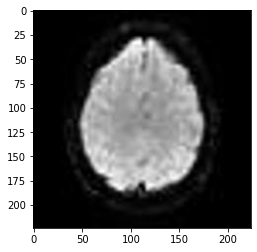

[[1.000000e+00 1.357575e-08 0.000000e+00 0.000000e+00 0.000000e+00]]


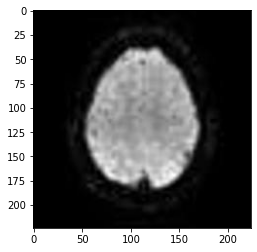

[[3.4371818e-33 1.0000000e+00 0.0000000e+00 2.2511635e-15 0.0000000e+00]]


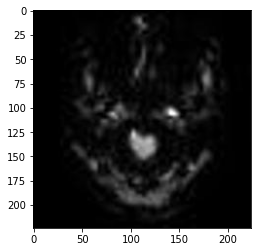

[[0.0000000e+00 2.3393227e-22 0.0000000e+00 1.0000000e+00 0.0000000e+00]]


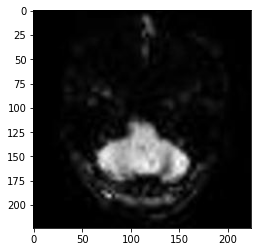

[[0. 1. 0. 0. 0.]]


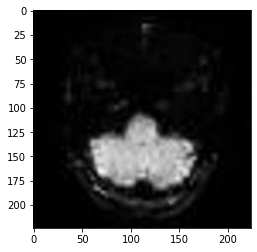

[[0. 1. 0. 0. 0.]]


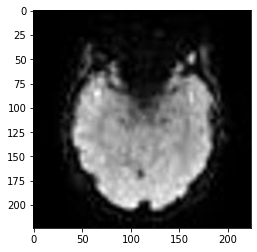

[[0.000000e+00 0.000000e+00 1.000000e+00 7.199794e-30 0.000000e+00]]


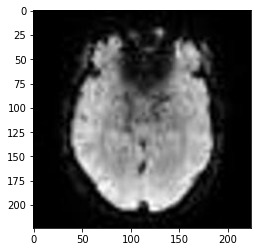

[[0.0000000e+00 5.7258404e-19 0.0000000e+00 1.0000000e+00 0.0000000e+00]]


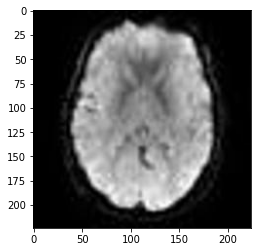

[[3.1473503e-22 1.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00]]


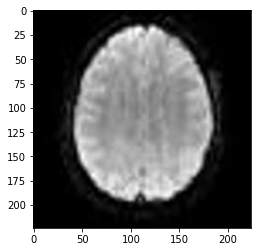

[[5.3230957e-36 0.0000000e+00 0.0000000e+00 1.0000000e+00 0.0000000e+00]]


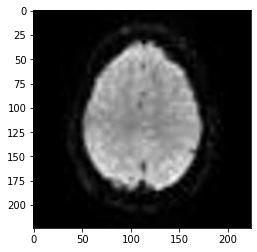

[[0.0000000e+00 1.0000000e+00 0.0000000e+00 1.3620895e-32 0.0000000e+00]]


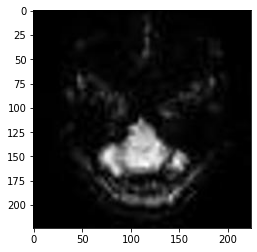

[[0. 1. 0. 0. 0.]]


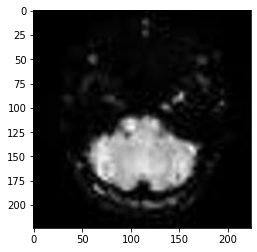

[[0. 1. 0. 0. 0.]]


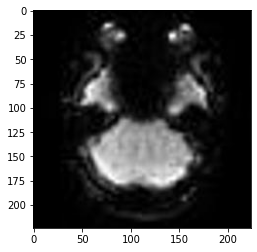

[[0. 1. 0. 0. 0.]]


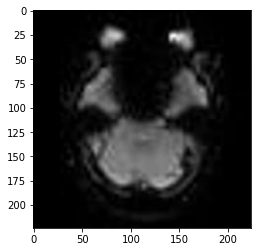

[[0.0000000e+00 1.0000000e+00 0.0000000e+00 5.2021594e-24 0.0000000e+00]]


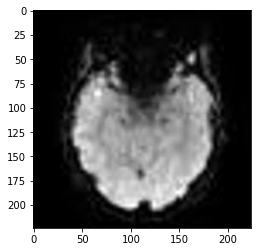

[[0.000000e+00 0.000000e+00 6.235658e-30 1.000000e+00 0.000000e+00]]


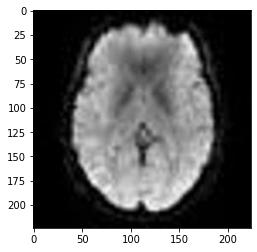

[[0. 0. 0. 1. 0.]]


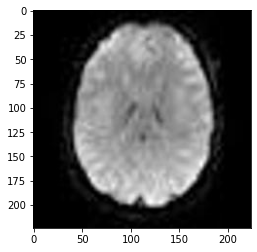

[[8.1972539e-20 1.0000000e+00 0.0000000e+00 1.8601211e-34 0.0000000e+00]]


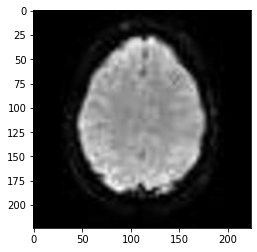

[[0. 0. 0. 1. 0.]]


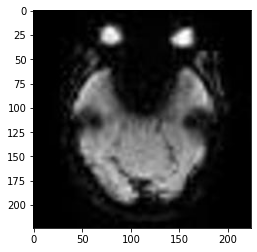

[[1. 0. 0. 0. 0.]]


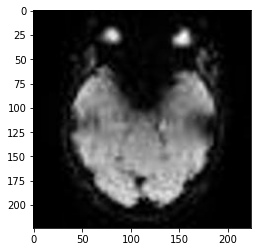

[[3.6484387e-24 1.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00]]


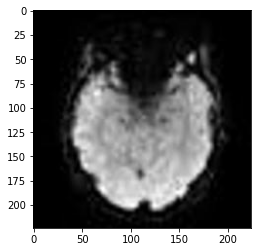

[[0.00000000e+00 0.00000000e+00 1.00000000e+00 1.12044315e-14
  0.00000000e+00]]


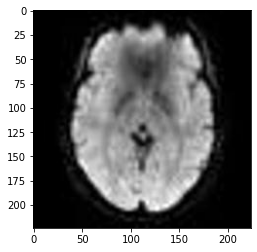

[[0. 0. 0. 1. 0.]]


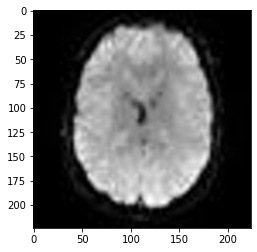

[[1.0000000e+00 0.0000000e+00 0.0000000e+00 6.8986314e-17 0.0000000e+00]]


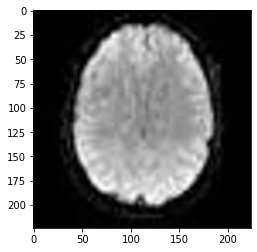

[[0.00000000e+00 1.31587666e-20 0.00000000e+00 1.00000000e+00
  0.00000000e+00]]


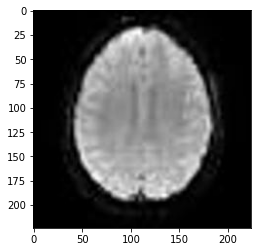

[[2.8762761e-06 0.0000000e+00 0.0000000e+00 9.9999714e-01 0.0000000e+00]]


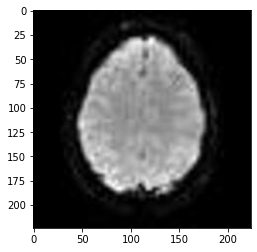

[[1.1973703e-27 0.0000000e+00 0.0000000e+00 1.0000000e+00 0.0000000e+00]]


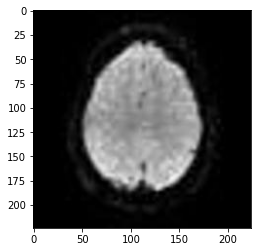

[[0. 1. 0. 0. 0.]]


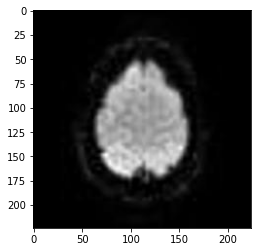

[[0. 1. 0. 0. 0.]]


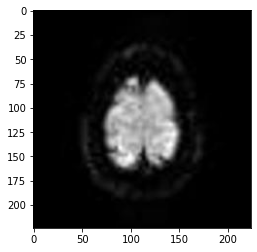

[[0.0000000e+00 6.0018773e-15 0.0000000e+00 0.0000000e+00 1.0000000e+00]]


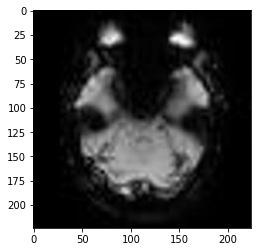

[[3.4254387e-25 8.1718498e-01 0.0000000e+00 1.8281500e-01 0.0000000e+00]]


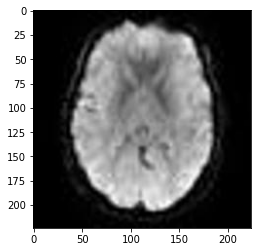

[[0. 1. 0. 0. 0.]]


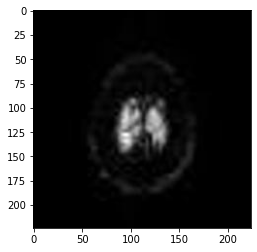

[[0.000000e+00 1.000000e+00 0.000000e+00 0.000000e+00 6.070538e-31]]


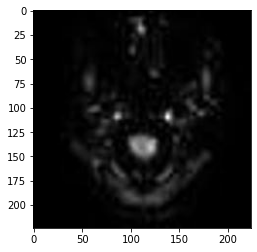

[[0.         0.99779    0.         0.00220998 0.        ]]


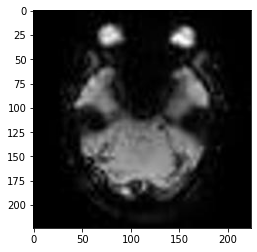

[[0. 1. 0. 0. 0.]]


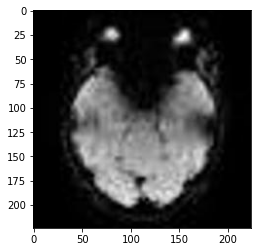

[[2.2949414e-38 2.2424151e-09 0.0000000e+00 1.0000000e+00 0.0000000e+00]]


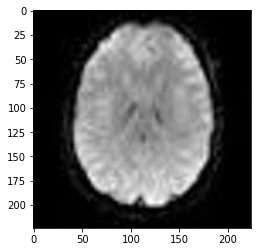

[[1.0000000e+00 2.1699099e-36 0.0000000e+00 2.0823650e-17 0.0000000e+00]]


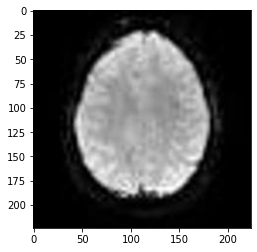

[[1.0000000e+00 0.0000000e+00 0.0000000e+00 1.7670128e-37 0.0000000e+00]]


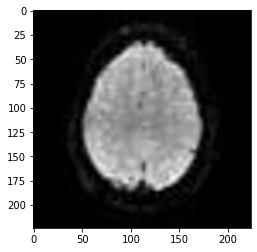

[[0. 1. 0. 0. 0.]]


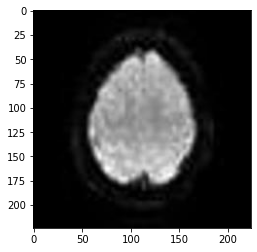

[[1.9727838e-18 1.0000000e+00 0.0000000e+00 0.0000000e+00 2.3663004e-16]]


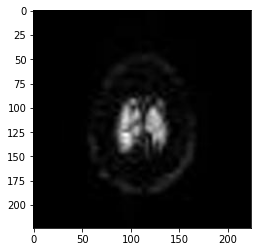

[[0. 1. 0. 0. 0.]]


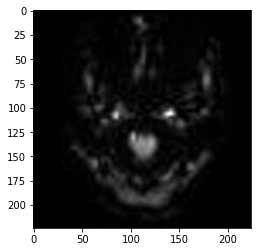

[[0.000000e+00 7.167748e-33 0.000000e+00 1.000000e+00 0.000000e+00]]


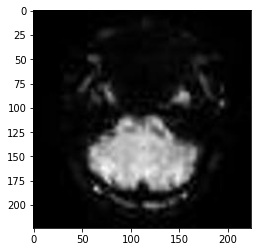

[[0.0000000e+00 1.0000000e+00 0.0000000e+00 1.2409369e-14 0.0000000e+00]]


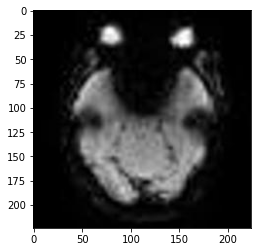

[[1. 0. 0. 0. 0.]]


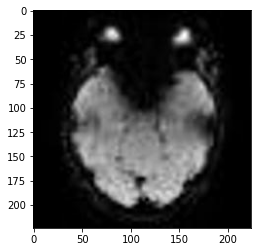

[[0. 0. 0. 1. 0.]]


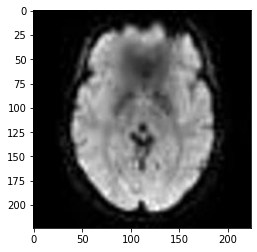

[[0. 0. 0. 1. 0.]]


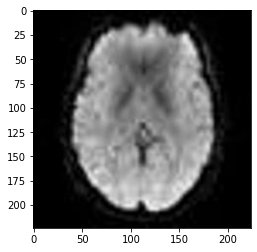

[[0. 0. 0. 1. 0.]]


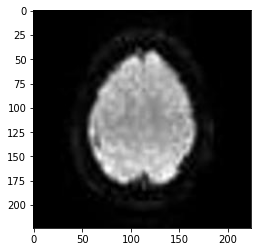

[[5.6359613e-38 1.0000000e+00 0.0000000e+00 0.0000000e+00 1.9298267e-27]]


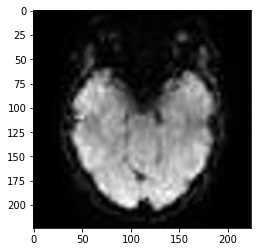

[[0. 0. 0. 1. 0.]]


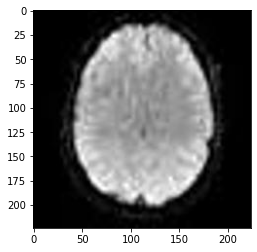

[[0.0000000e+00 0.0000000e+00 4.0487337e-28 1.0000000e+00 0.0000000e+00]]


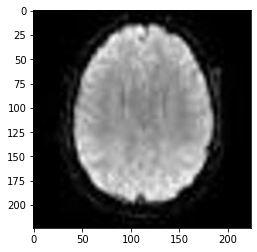

[[0. 1. 0. 0. 0.]]


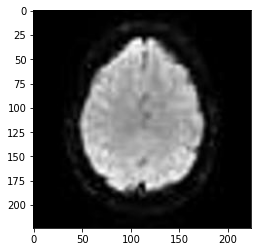

[[8.687386e-24 1.000000e+00 0.000000e+00 0.000000e+00 0.000000e+00]]


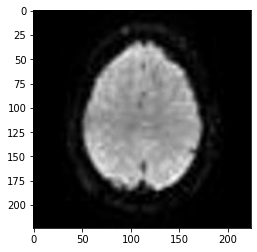

[[0. 1. 0. 0. 0.]]


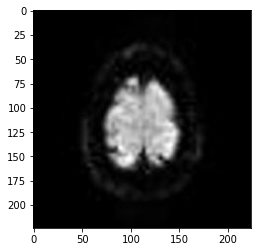

[[0.0000000e+00 1.4141323e-29 0.0000000e+00 0.0000000e+00 1.0000000e+00]]


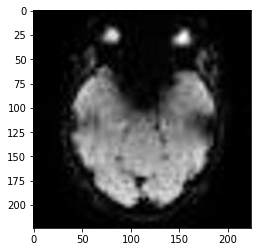

[[5.8700705e-23 2.7407292e-16 0.0000000e+00 1.0000000e+00 0.0000000e+00]]


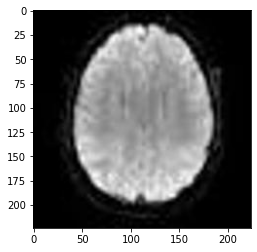

[[0.000000e+00 9.994516e-01 0.000000e+00 5.484165e-04 0.000000e+00]]


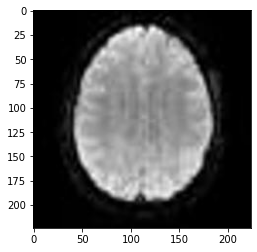

[[0. 0. 0. 1. 0.]]


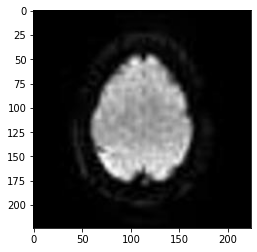

[[0.000000e+00 1.000000e+00 0.000000e+00 0.000000e+00 9.765084e-36]]


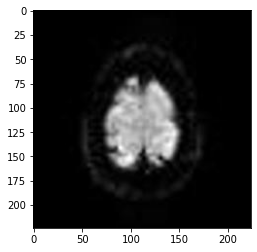

[[0.000000e+00 2.425359e-21 0.000000e+00 0.000000e+00 1.000000e+00]]


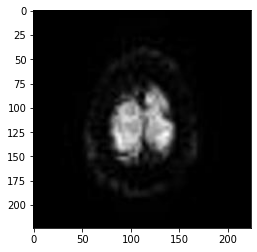

[[0.000000e+00 1.000000e+00 0.000000e+00 0.000000e+00 6.517475e-11]]


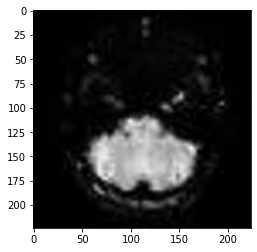

[[0. 1. 0. 0. 0.]]


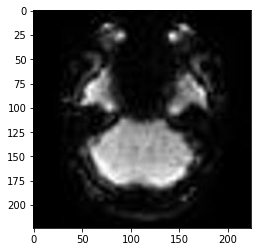

[[0. 1. 0. 0. 0.]]


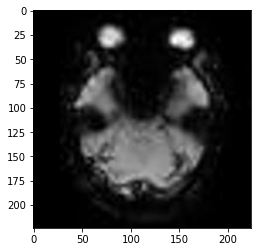

[[0. 1. 0. 0. 0.]]


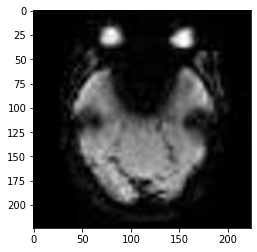

[[1. 0. 0. 0. 0.]]


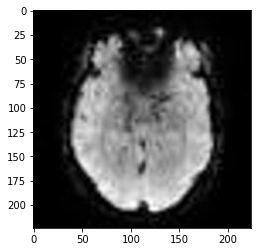

[[0.0000000e+00 0.0000000e+00 1.0000000e+00 3.3655888e-17 0.0000000e+00]]


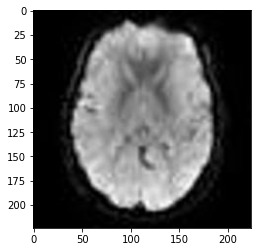

[[0. 1. 0. 0. 0.]]


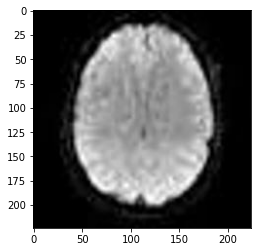

[[0.0000000e+00 0.0000000e+00 3.7093934e-13 1.0000000e+00 0.0000000e+00]]


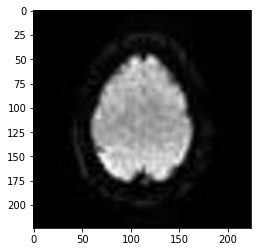

[[0.0000000e+00 1.0000000e+00 0.0000000e+00 0.0000000e+00 1.6983595e-23]]


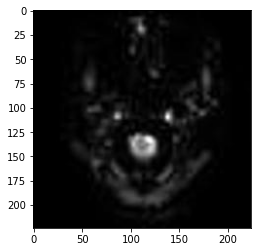

[[0.000000e+00 0.000000e+00 0.000000e+00 3.182786e-04 9.996817e-01]]


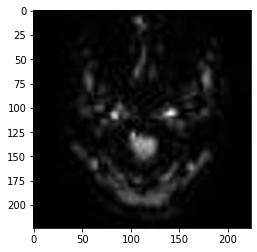

[[0.0000000e+00 1.0000000e+00 0.0000000e+00 1.5023447e-25 0.0000000e+00]]


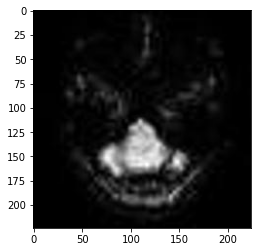

[[0.0000000e+00 1.0000000e+00 0.0000000e+00 3.7829914e-26 0.0000000e+00]]


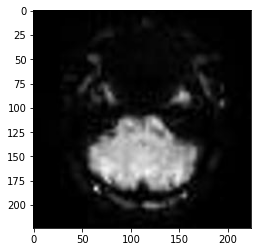

[[0. 1. 0. 0. 0.]]


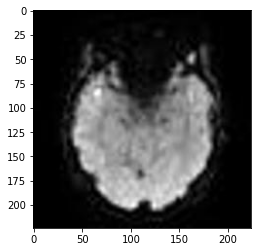

[[0.000000e+00 0.000000e+00 1.000000e+00 2.224477e-16 0.000000e+00]]


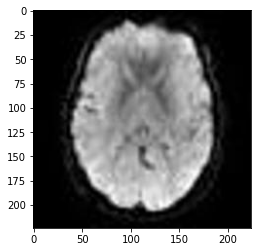

[[0.0000000e+00 1.0000000e+00 0.0000000e+00 8.2460455e-37 2.3976848e-16]]


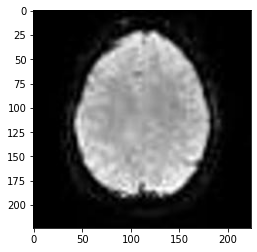

[[1. 0. 0. 0. 0.]]


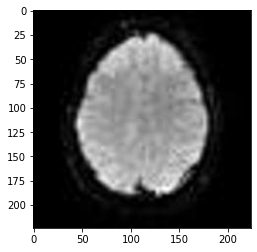

[[1. 0. 0. 0. 0.]]


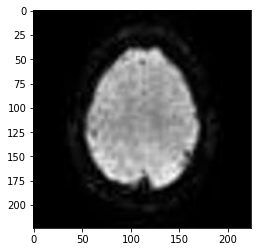

[[0.0000000e+00 1.0000000e+00 0.0000000e+00 1.3519704e-08 0.0000000e+00]]


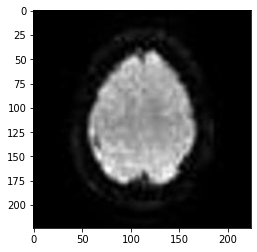

[[1.0735178e-17 1.0000000e+00 0.0000000e+00 0.0000000e+00 4.8617303e-22]]


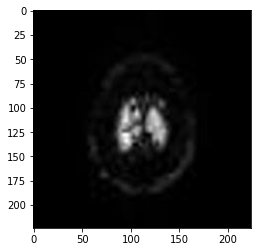

[[0.0000000e+00 5.5893497e-07 0.0000000e+00 0.0000000e+00 9.9999940e-01]]


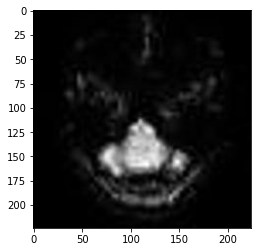

[[0. 1. 0. 0. 0.]]


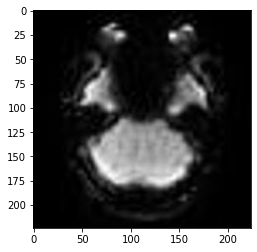

[[0.0000000e+00 6.0368604e-26 0.0000000e+00 1.0000000e+00 0.0000000e+00]]


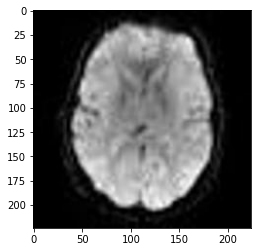

[[0. 0. 0. 1. 0.]]


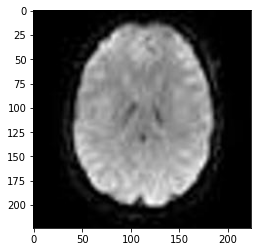

[[0.17817785 0.         0.         0.8218221  0.        ]]


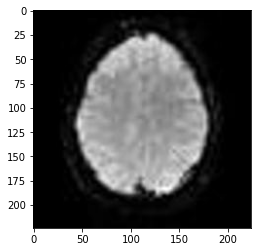

[[1.0000000e+00 5.1422266e-10 0.0000000e+00 0.0000000e+00 0.0000000e+00]]


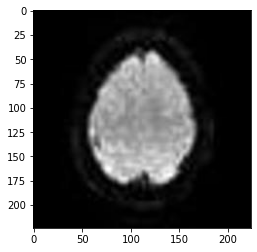

[[1.7201724e-34 9.9999952e-01 0.0000000e+00 0.0000000e+00 4.3380052e-07]]


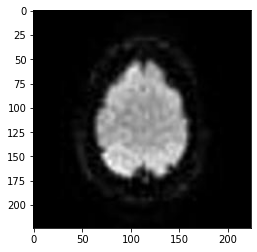

[[0. 1. 0. 0. 0.]]


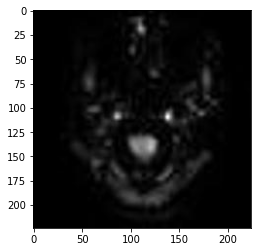

[[0.0000000e+00 1.0000000e+00 0.0000000e+00 4.2783137e-32 0.0000000e+00]]


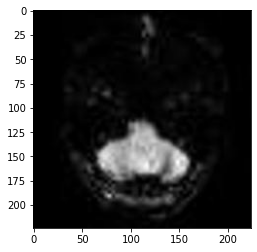

[[0. 1. 0. 0. 0.]]


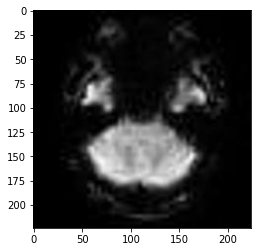

[[0. 0. 0. 1. 0.]]


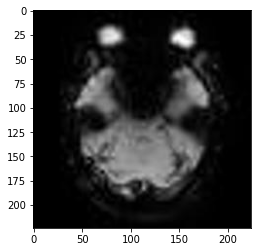

[[4.1107666e-01 5.8892328e-01 0.0000000e+00 2.8683885e-08 0.0000000e+00]]


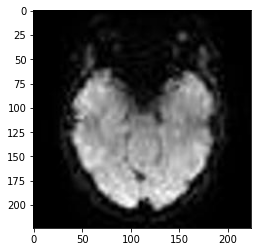

[[0.0000000e+00 1.3422542e-21 0.0000000e+00 1.0000000e+00 0.0000000e+00]]


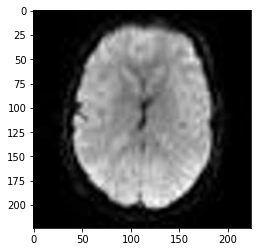

[[1.3789164e-35 1.0000000e+00 0.0000000e+00 0.0000000e+00 7.5276209e-12]]


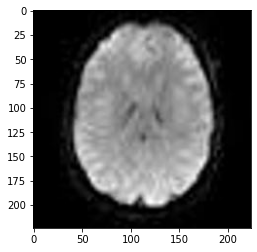

[[1.0000000e+00 0.0000000e+00 0.0000000e+00 4.8394496e-23 0.0000000e+00]]


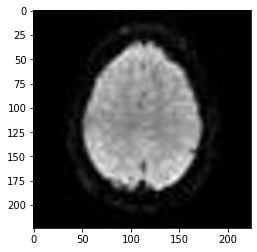

[[0. 1. 0. 0. 0.]]


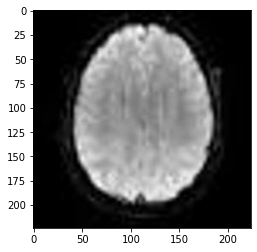

[[0.0000000e+00 1.0000000e+00 0.0000000e+00 2.8399988e-31 0.0000000e+00]]


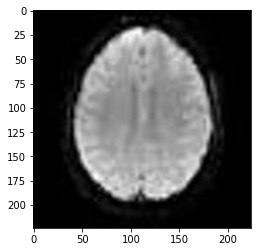

[[0.08825848 0.         0.         0.9117415  0.        ]]


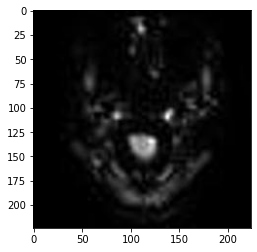

[[0. 0. 0. 1. 0.]]


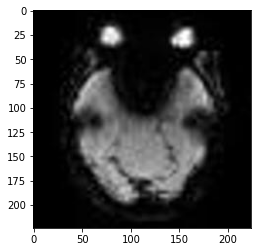

[[1. 0. 0. 0. 0.]]


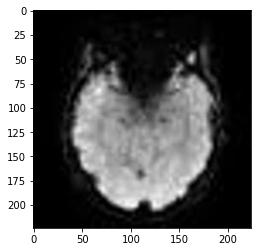

[[0.000000e+00 0.000000e+00 8.012739e-21 1.000000e+00 0.000000e+00]]


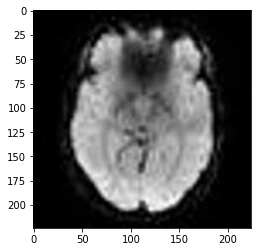

[[1.0444358e-36 1.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00]]


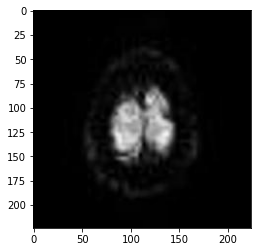

[[0.0000000e+00 1.6550147e-17 0.0000000e+00 0.0000000e+00 1.0000000e+00]]


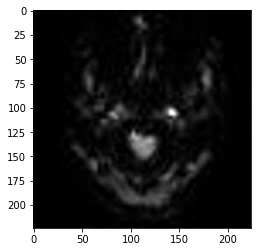

[[0.0000000e+00 1.0000000e+00 0.0000000e+00 1.0532363e-09 0.0000000e+00]]


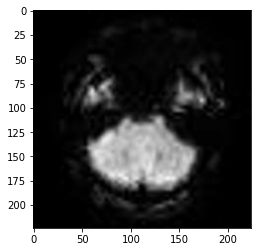

[[0. 0. 0. 1. 0.]]


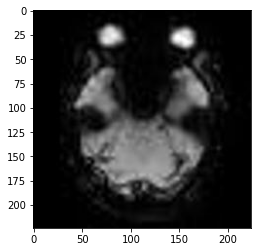

[[0. 1. 0. 0. 0.]]


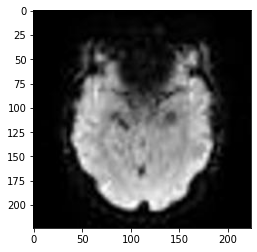

[[0.0000000e+00 2.7025479e-07 9.9999976e-01 0.0000000e+00 0.0000000e+00]]


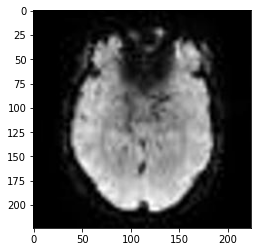

[[0.0000000e+00 2.3896203e-07 8.8303921e-20 9.9998701e-01 1.2717068e-05]]


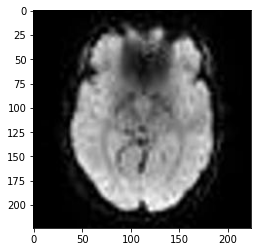

[[0.         0.01107057 0.         0.98892945 0.        ]]


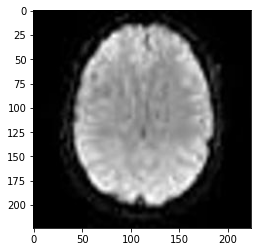

[[0. 0. 0. 1. 0.]]


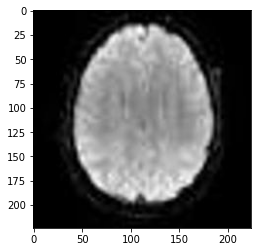

[[0. 1. 0. 0. 0.]]


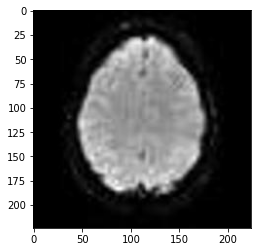

[[9.9999905e-01 9.5425287e-07 0.0000000e+00 5.9123910e-20 0.0000000e+00]]


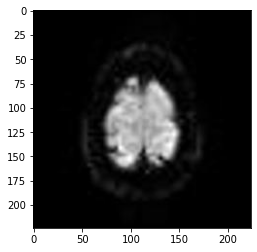

[[0.0000000e+00 3.2111584e-11 0.0000000e+00 0.0000000e+00 1.0000000e+00]]


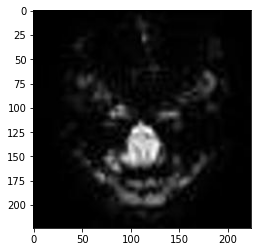

[[0. 1. 0. 0. 0.]]


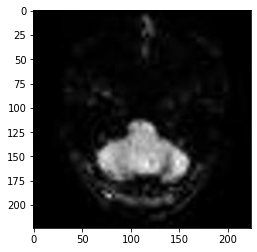

[[0. 1. 0. 0. 0.]]


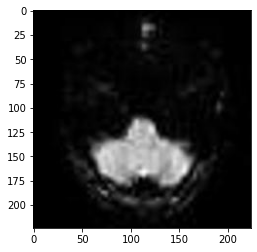

[[0. 1. 0. 0. 0.]]


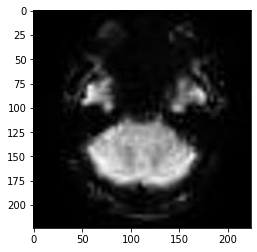

[[0. 0. 0. 1. 0.]]


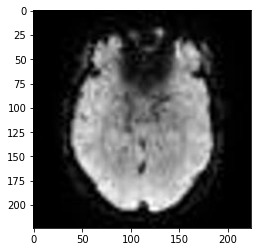

[[0.0000000e+00 0.0000000e+00 3.8451122e-28 1.0000000e+00 0.0000000e+00]]


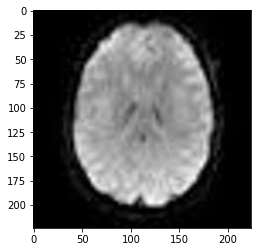

[[1.0000000e+00 4.3975099e-20 0.0000000e+00 1.0626144e-33 0.0000000e+00]]


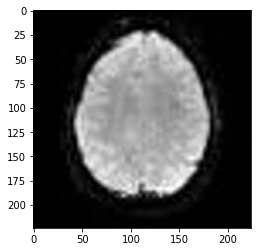

[[1. 0. 0. 0. 0.]]


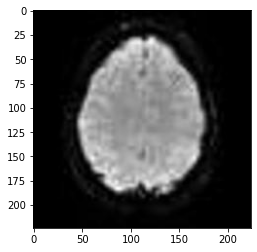

[[1.0000000e+00 3.0349955e-31 0.0000000e+00 4.3666195e-12 0.0000000e+00]]


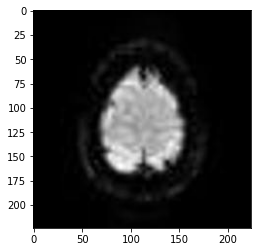

[[0. 1. 0. 0. 0.]]


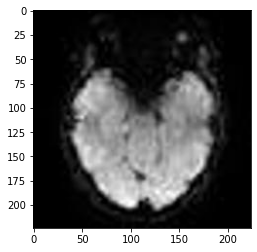

[[0.0000000e+00 4.2984917e-36 0.0000000e+00 1.0000000e+00 0.0000000e+00]]


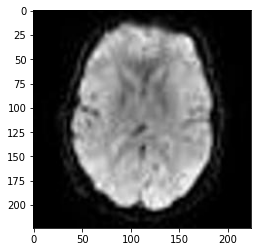

[[0. 0. 0. 1. 0.]]


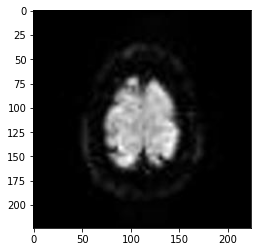

[[0. 0. 0. 0. 1.]]


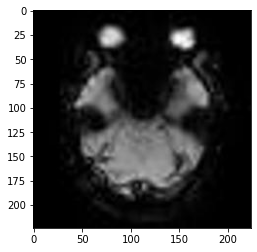

[[0. 1. 0. 0. 0.]]


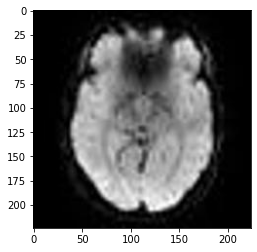

[[0.0000000e+00 1.0894393e-22 0.0000000e+00 1.0000000e+00 0.0000000e+00]]


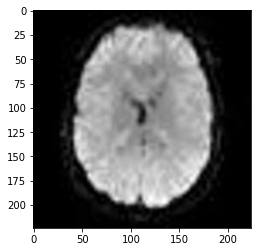

[[2.4239202e-10 1.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00]]


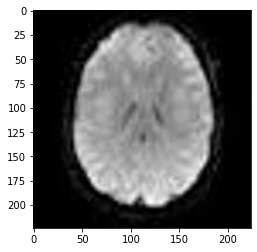

[[1.0000000e+00 1.5200476e-18 0.0000000e+00 0.0000000e+00 0.0000000e+00]]


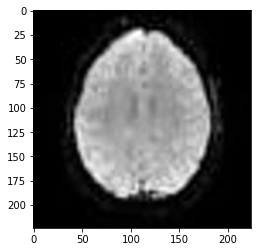

[[1. 0. 0. 0. 0.]]


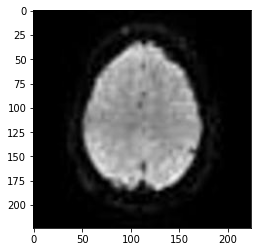

[[0. 1. 0. 0. 0.]]


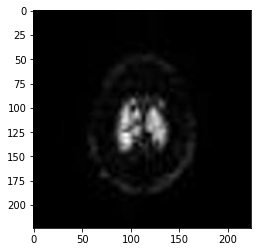

[[0.0000000e+00 1.0000000e+00 0.0000000e+00 0.0000000e+00 1.3928173e-09]]


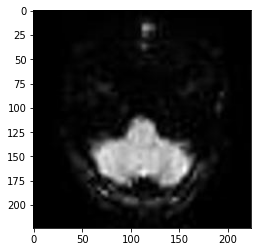

[[0. 1. 0. 0. 0.]]


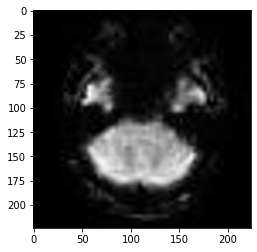

[[0. 0. 0. 1. 0.]]


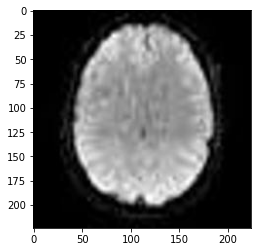

[[0.0000000e+00 0.0000000e+00 2.3089866e-12 1.0000000e+00 0.0000000e+00]]


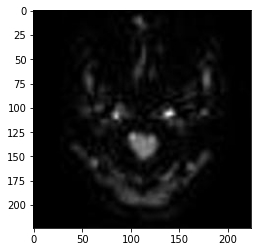

[[0.000000e+00 8.912794e-24 0.000000e+00 1.000000e+00 0.000000e+00]]


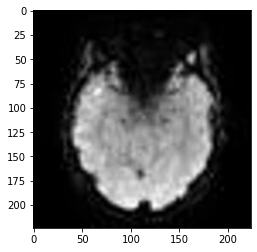

[[0. 0. 0. 1. 0.]]


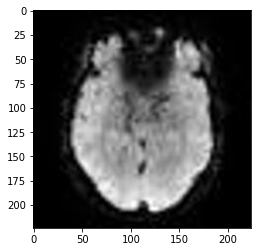

[[0. 0. 0. 1. 0.]]


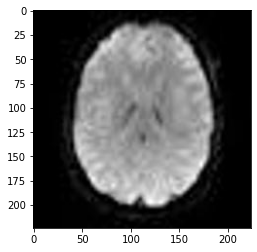

[[1.0000000e+00 6.7415616e-21 0.0000000e+00 1.3059020e-25 0.0000000e+00]]


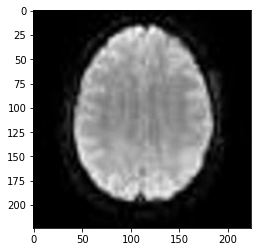

[[9.9999988e-01 0.0000000e+00 0.0000000e+00 9.1816986e-08 0.0000000e+00]]


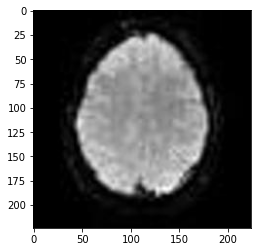

[[1.0622382e-24 0.0000000e+00 0.0000000e+00 1.0000000e+00 0.0000000e+00]]


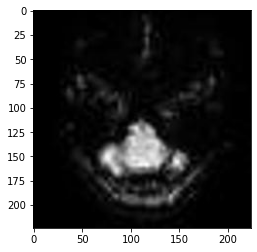

[[0. 1. 0. 0. 0.]]


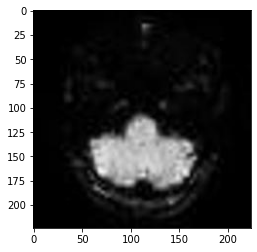

[[0. 1. 0. 0. 0.]]


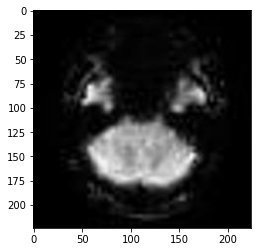

[[0. 0. 0. 1. 0.]]


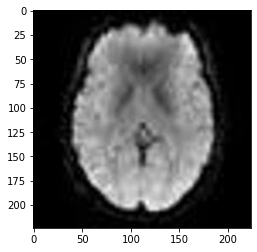

[[0. 0. 0. 1. 0.]]


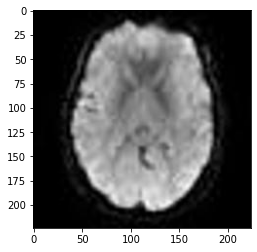

[[1.7229110e-35 1.0000000e+00 0.0000000e+00 4.9728075e-23 5.3666355e-10]]


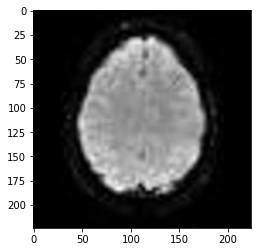

[[1.1456783e-13 2.7147647e-33 0.0000000e+00 1.0000000e+00 0.0000000e+00]]


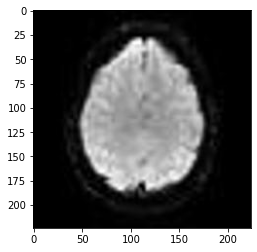

[[0. 1. 0. 0. 0.]]


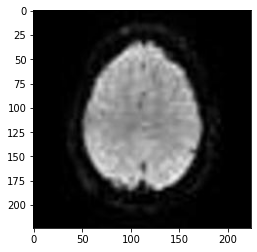

[[0. 1. 0. 0. 0.]]


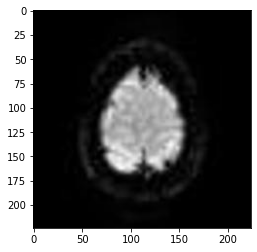

[[0. 1. 0. 0. 0.]]


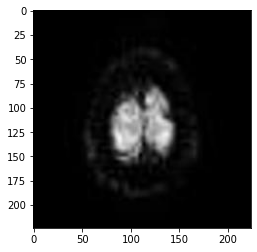

[[0. 0. 0. 0. 1.]]


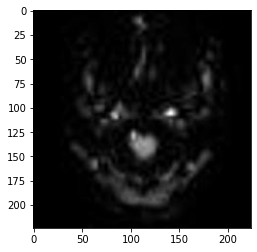

[[0. 0. 0. 1. 0.]]


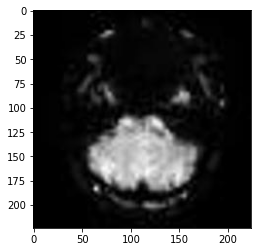

[[0. 1. 0. 0. 0.]]


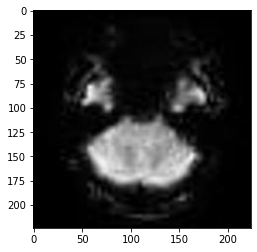

[[0. 0. 0. 1. 0.]]


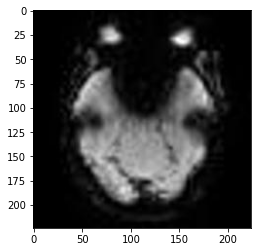

[[1.0000000e+00 0.0000000e+00 0.0000000e+00 2.8024033e-34 0.0000000e+00]]


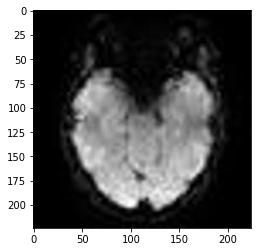

[[0.0000000e+00 7.1437214e-12 0.0000000e+00 1.0000000e+00 0.0000000e+00]]


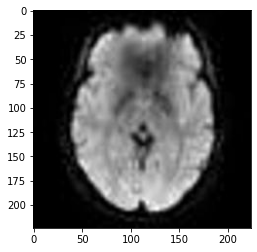

[[0. 0. 0. 1. 0.]]


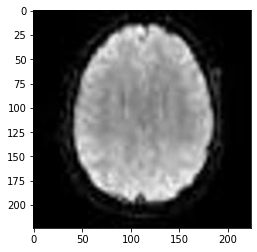

[[0.0000000e+00 3.2344433e-11 0.0000000e+00 1.0000000e+00 0.0000000e+00]]


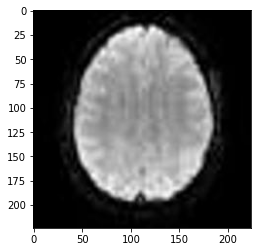

[[2.680772e-19 0.000000e+00 0.000000e+00 1.000000e+00 0.000000e+00]]


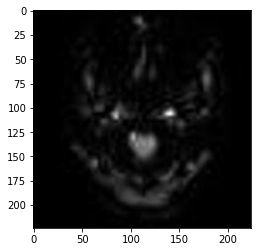

[[0.0000000e+00 2.0689399e-21 0.0000000e+00 1.0000000e+00 0.0000000e+00]]


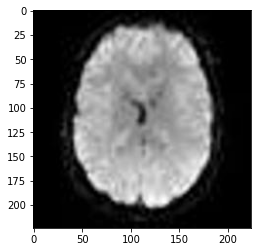

[[9.9970800e-01 2.2579226e-19 0.0000000e+00 2.9199300e-04 5.3276402e-34]]


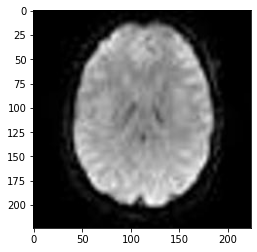

[[1.0000000e+00 0.0000000e+00 0.0000000e+00 1.5156131e-17 0.0000000e+00]]


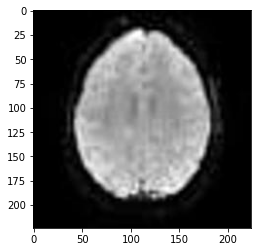

[[1. 0. 0. 0. 0.]]


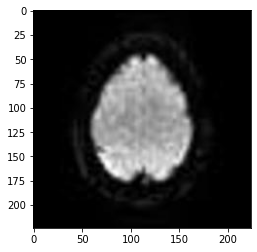

[[0. 1. 0. 0. 0.]]


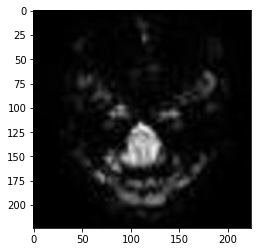

[[0. 1. 0. 0. 0.]]


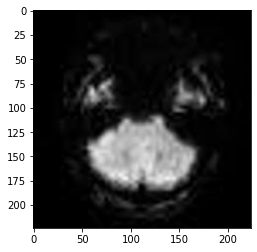

[[0. 0. 0. 1. 0.]]


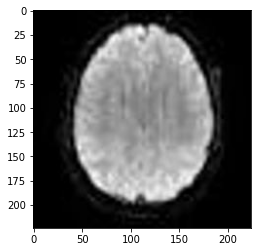

[[0.0000000e+00 2.7342978e-30 0.0000000e+00 1.0000000e+00 0.0000000e+00]]


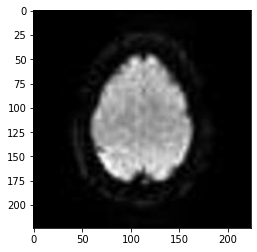

[[0.0000000e+00 1.0000000e+00 0.0000000e+00 0.0000000e+00 1.0460472e-20]]


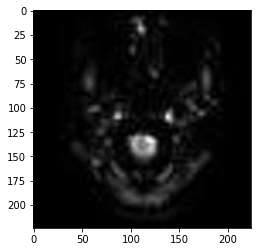

[[0.0000000e+00 0.0000000e+00 0.0000000e+00 1.0000000e+00 1.0695439e-26]]


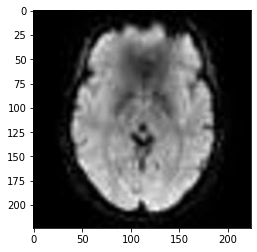

[[0. 0. 0. 1. 0.]]


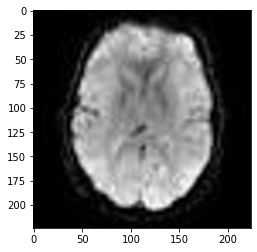

[[0. 0. 0. 1. 0.]]


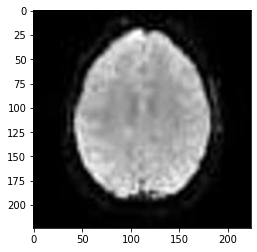

[[1. 0. 0. 0. 0.]]


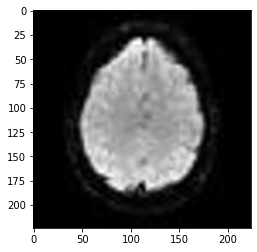

[[1.0000000e+00 5.2172378e-11 0.0000000e+00 0.0000000e+00 0.0000000e+00]]


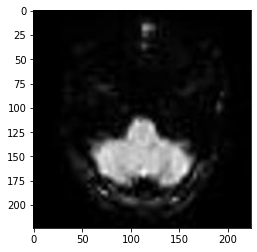

[[0. 1. 0. 0. 0.]]


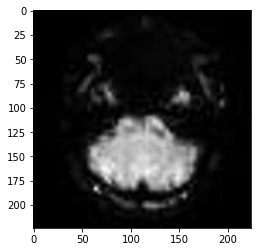

[[0. 1. 0. 0. 0.]]


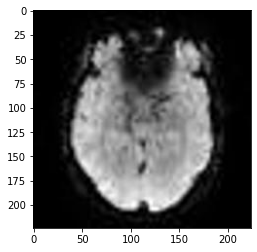

[[0.0000000e+00 1.2801640e-19 7.6048651e-10 1.0000000e+00 2.4985652e-18]]


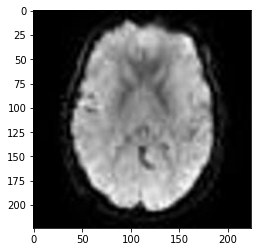

[[0. 1. 0. 0. 0.]]


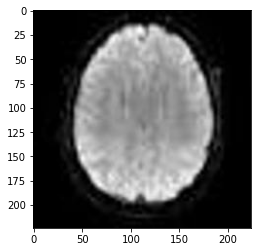

[[0.0000000e+00 9.9999917e-01 0.0000000e+00 8.9203974e-07 0.0000000e+00]]


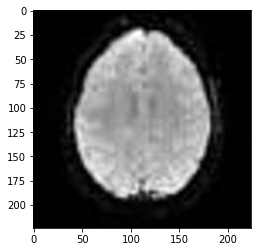

[[1.0000000e+00 0.0000000e+00 0.0000000e+00 6.1474194e-30 0.0000000e+00]]


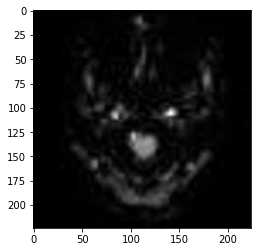

[[0. 0. 0. 1. 0.]]


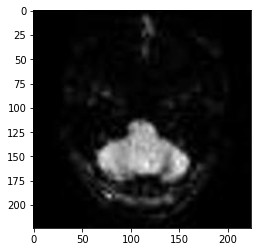

[[0. 1. 0. 0. 0.]]


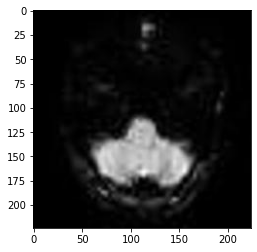

[[0. 1. 0. 0. 0.]]


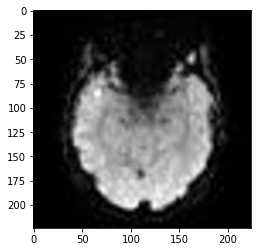

[[0. 0. 0. 1. 0.]]


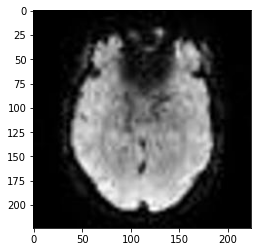

[[0. 0. 0. 1. 0.]]


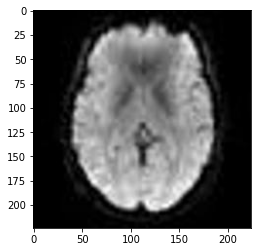

[[0. 0. 0. 1. 0.]]


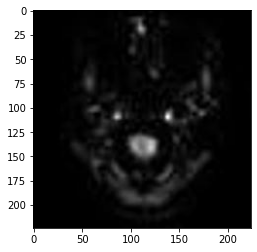

[[0.0000000e+00 1.9936743e-23 0.0000000e+00 1.0000000e+00 0.0000000e+00]]


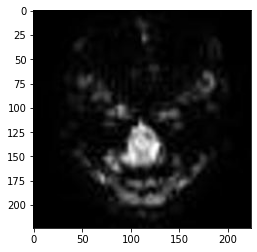

[[0. 1. 0. 0. 0.]]


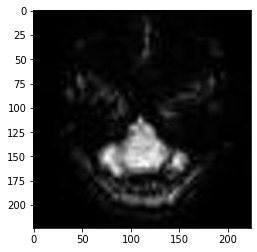

[[0. 1. 0. 0. 0.]]


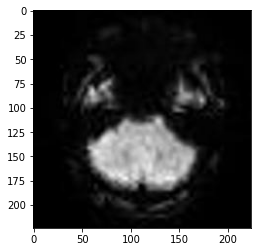

[[0. 0. 0. 1. 0.]]


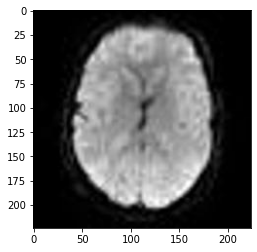

[[0. 0. 0. 1. 0.]]


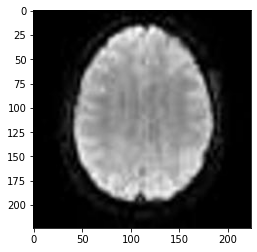

[[0. 0. 0. 1. 0.]]


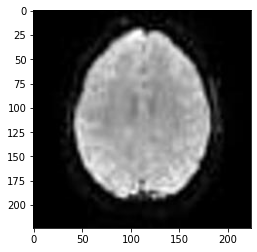

[[1. 0. 0. 0. 0.]]


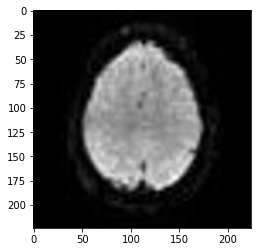

[[0. 1. 0. 0. 0.]]


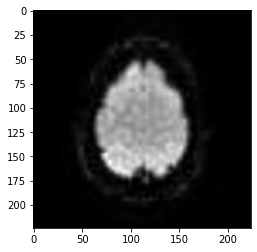

[[0. 1. 0. 0. 0.]]


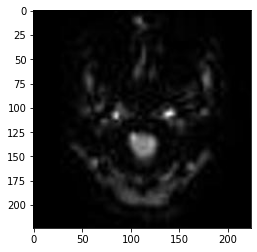

[[0. 0. 0. 1. 0.]]


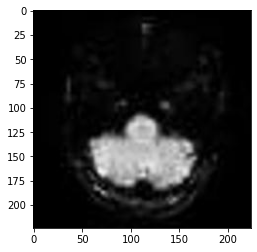

[[0. 1. 0. 0. 0.]]


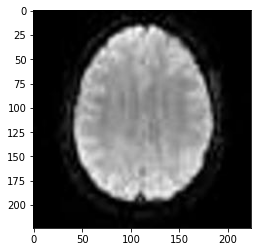

[[9.9840850e-01 6.2807893e-30 0.0000000e+00 1.5914744e-03 0.0000000e+00]]


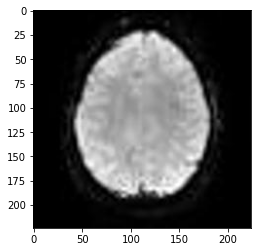

[[1. 0. 0. 0. 0.]]


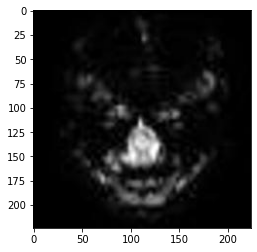

[[0. 1. 0. 0. 0.]]


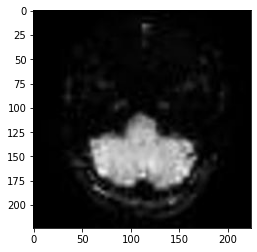

[[0. 1. 0. 0. 0.]]


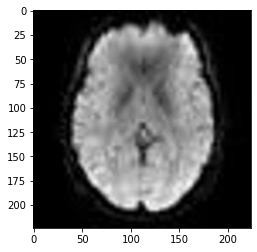

[[0. 0. 0. 1. 0.]]


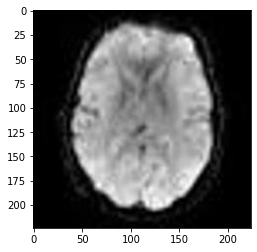

[[0. 0. 0. 1. 0.]]


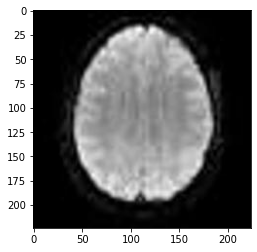

[[1. 0. 0. 0. 0.]]


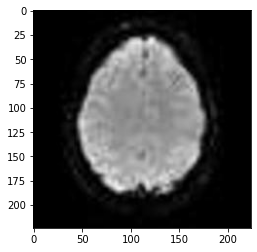

[[1. 0. 0. 0. 0.]]


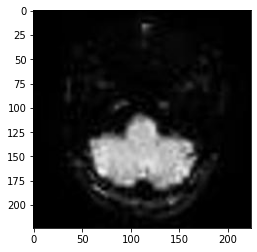

[[0. 1. 0. 0. 0.]]


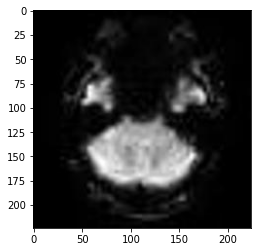

[[0. 0. 0. 1. 0.]]


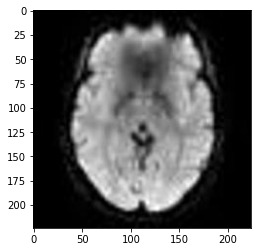

[[0. 0. 0. 1. 0.]]


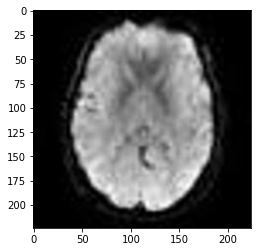

[[2.6552264e-34 1.0000000e+00 0.0000000e+00 1.7937772e-23 2.2948474e-21]]


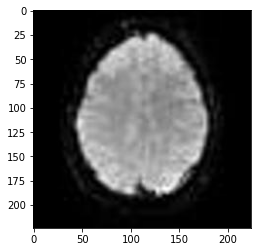

[[1. 0. 0. 0. 0.]]


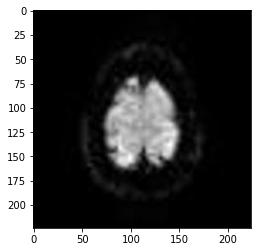

[[0.0000000e+00 3.8600613e-34 0.0000000e+00 0.0000000e+00 1.0000000e+00]]


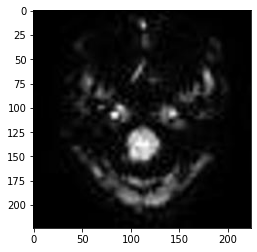

[[0.0000000e+00 1.0000000e+00 0.0000000e+00 2.0228336e-28 0.0000000e+00]]


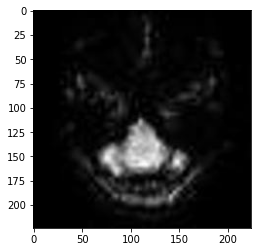

[[0. 1. 0. 0. 0.]]


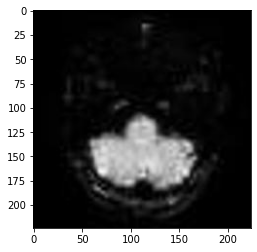

[[0. 1. 0. 0. 0.]]


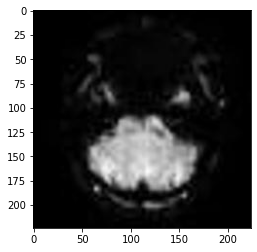

[[0. 1. 0. 0. 0.]]


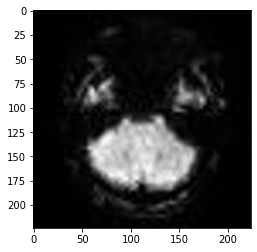

[[0. 0. 0. 1. 0.]]


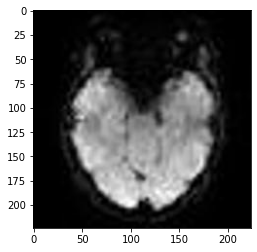

[[0.0000000e+00 1.7561151e-35 0.0000000e+00 1.0000000e+00 0.0000000e+00]]


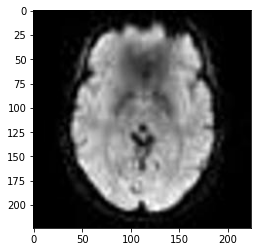

[[0. 0. 0. 1. 0.]]


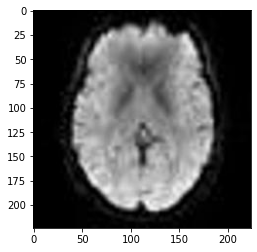

[[0. 0. 0. 1. 0.]]


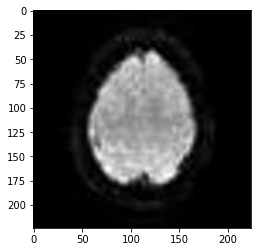

[[1.0000000e+00 5.0758357e-33 0.0000000e+00 0.0000000e+00 1.6411494e-20]]


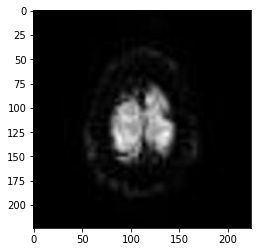

[[0.0000000e+00 1.0000000e+00 0.0000000e+00 0.0000000e+00 1.8028927e-25]]


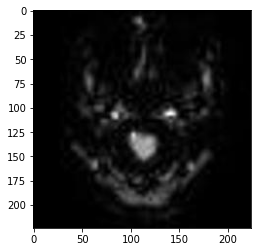

[[0. 0. 0. 1. 0.]]


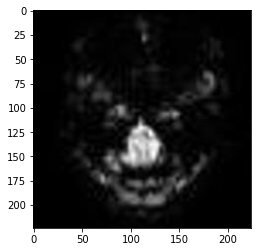

[[0. 1. 0. 0. 0.]]


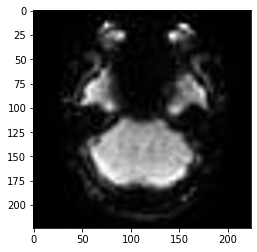

[[0.00000000e+00 1.00000000e+00 0.00000000e+00 1.20863706e-26
  0.00000000e+00]]


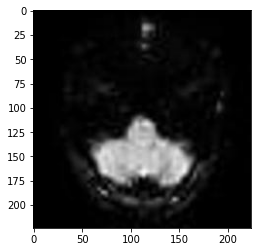

[[0. 1. 0. 0. 0.]]


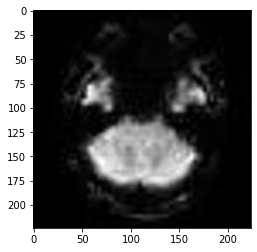

[[0. 0. 0. 1. 0.]]


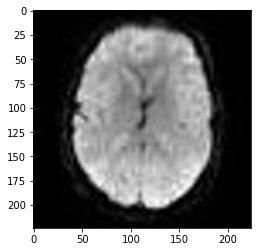

[[0. 0. 0. 1. 0.]]


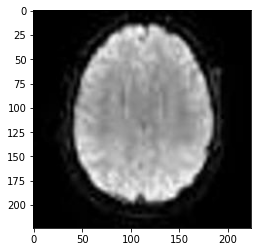

[[0. 1. 0. 0. 0.]]


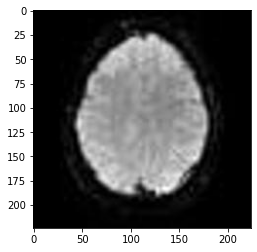

[[1.0000000e+00 6.7477365e-36 0.0000000e+00 0.0000000e+00 0.0000000e+00]]


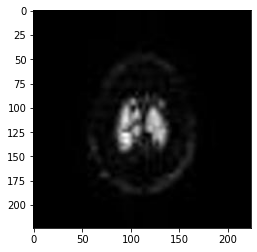

[[0.000000e+00 1.000000e+00 0.000000e+00 0.000000e+00 4.581568e-30]]


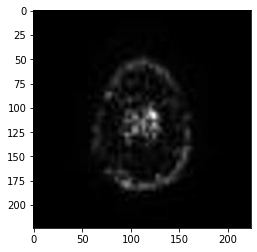

[[0. 1. 0. 0. 0.]]


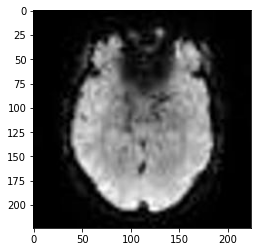

[[0.0000000e+00 0.0000000e+00 4.7466188e-18 1.0000000e+00 0.0000000e+00]]


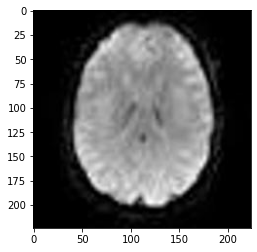

[[1.000000e+00 7.313866e-24 0.000000e+00 7.720799e-24 0.000000e+00]]


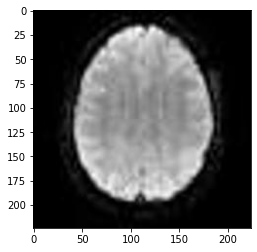

[[1.0193276e-28 0.0000000e+00 0.0000000e+00 1.0000000e+00 0.0000000e+00]]


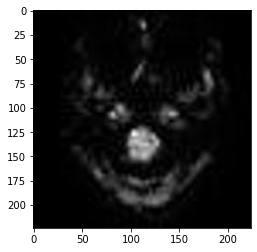

[[0. 1. 0. 0. 0.]]


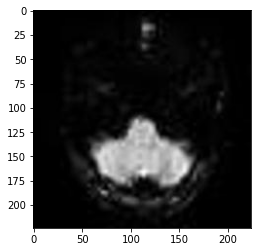

[[0. 1. 0. 0. 0.]]


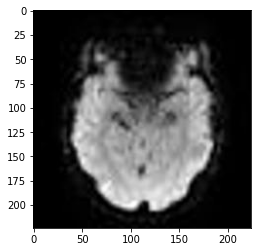

[[0. 0. 1. 0. 0.]]


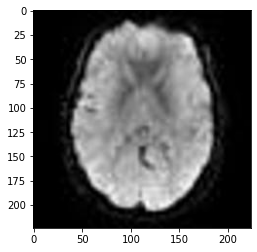

[[0.000000e+00 1.000000e+00 0.000000e+00 3.830022e-19 6.118962e-10]]


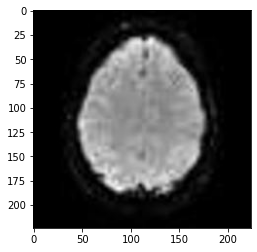

[[0. 0. 0. 1. 0.]]


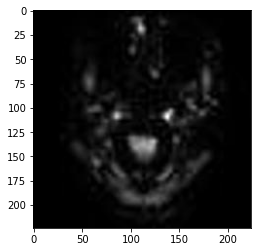

[[0. 1. 0. 0. 0.]]


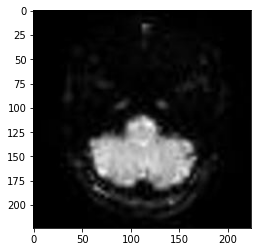

[[0. 1. 0. 0. 0.]]


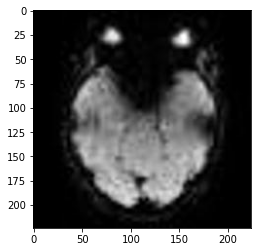

[[0.000000e+00 8.969972e-29 0.000000e+00 1.000000e+00 0.000000e+00]]


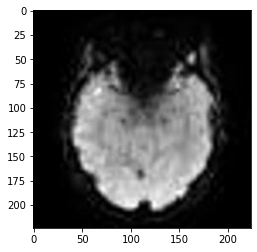

[[0. 0. 0. 1. 0.]]


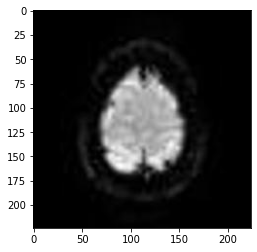

[[0. 1. 0. 0. 0.]]


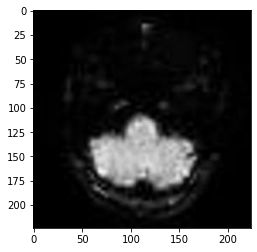

[[0. 1. 0. 0. 0.]]


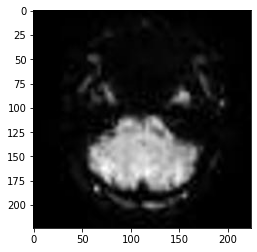

[[0. 1. 0. 0. 0.]]


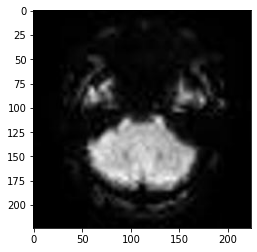

[[0. 0. 0. 1. 0.]]


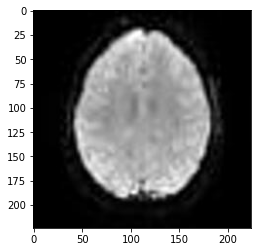

[[1. 0. 0. 0. 0.]]


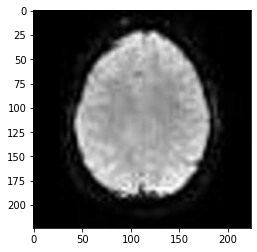

[[1. 0. 0. 0. 0.]]


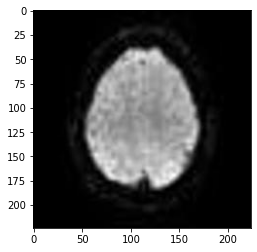

[[1.0077329e-20 1.0000000e+00 0.0000000e+00 5.9014715e-19 0.0000000e+00]]


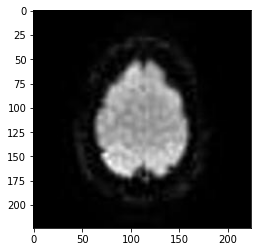

[[0.0000000e+00 9.9997902e-01 0.0000000e+00 0.0000000e+00 2.0974732e-05]]


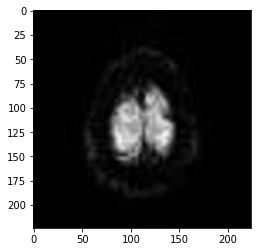

[[0.0000000e+00 1.8066257e-23 0.0000000e+00 0.0000000e+00 1.0000000e+00]]


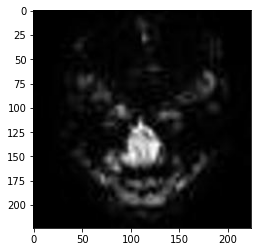

[[0. 1. 0. 0. 0.]]


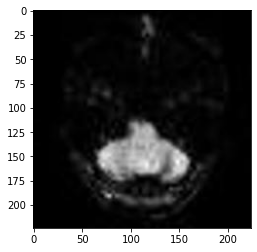

[[0. 1. 0. 0. 0.]]


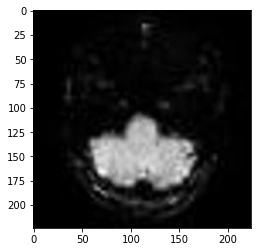

[[0. 1. 0. 0. 0.]]


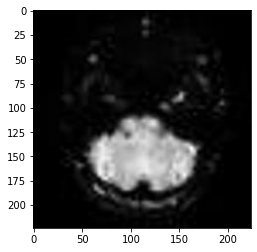

[[0. 1. 0. 0. 0.]]


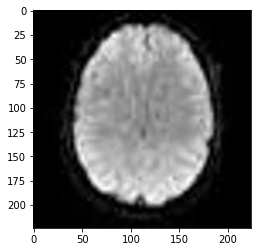

[[0. 0. 0. 1. 0.]]


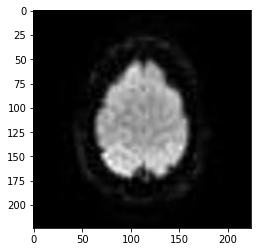

[[0. 1. 0. 0. 0.]]


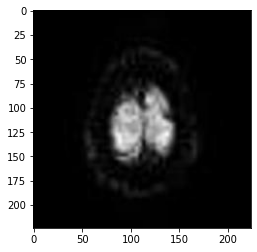

[[0.0000000e+00 1.0000000e+00 0.0000000e+00 0.0000000e+00 2.8570813e-08]]


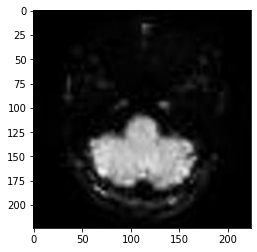

[[0. 1. 0. 0. 0.]]


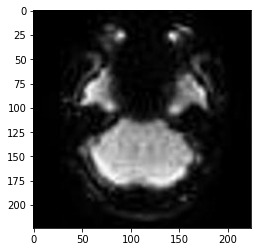

[[0. 1. 0. 0. 0.]]


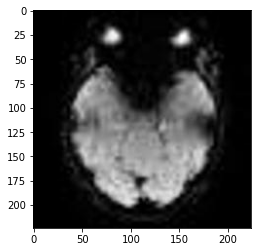

[[0.000000e+00 2.153638e-30 0.000000e+00 1.000000e+00 0.000000e+00]]


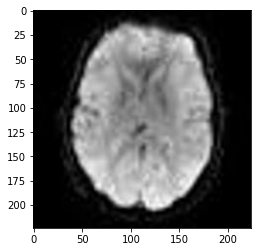

[[0. 0. 0. 1. 0.]]


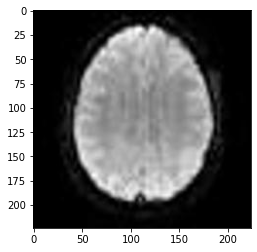

[[5.7426284e-23 0.0000000e+00 0.0000000e+00 1.0000000e+00 0.0000000e+00]]


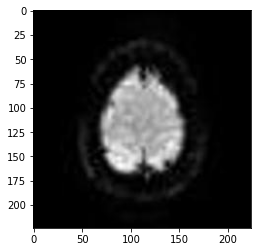

[[0. 1. 0. 0. 0.]]


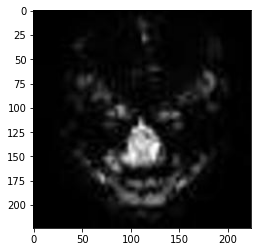

[[0. 1. 0. 0. 0.]]


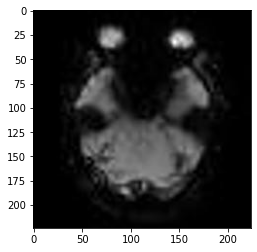

[[8.473951e-38 1.000000e+00 0.000000e+00 0.000000e+00 0.000000e+00]]


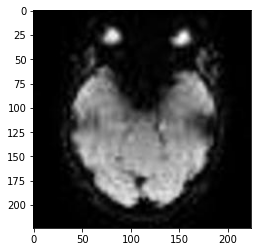

[[0.0000000e+00 1.0000000e+00 0.0000000e+00 1.9992776e-25 0.0000000e+00]]


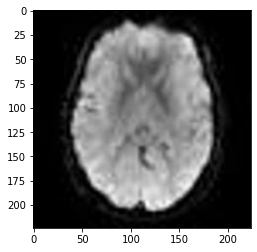

[[1.49897054e-01 8.50102961e-01 0.00000000e+00 2.55168866e-27
  1.06049757e-19]]


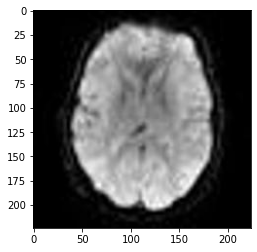

[[9.999702e-01 4.588962e-11 0.000000e+00 2.985745e-05 0.000000e+00]]


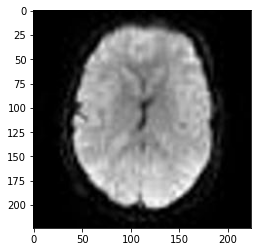

[[2.9917848e-38 2.7320008e-05 0.0000000e+00 9.9997270e-01 5.1988950e-27]]


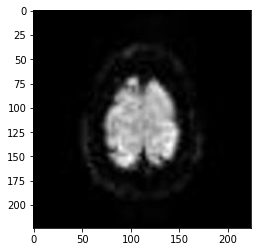

[[0.000000e+00 8.905005e-18 0.000000e+00 0.000000e+00 1.000000e+00]]


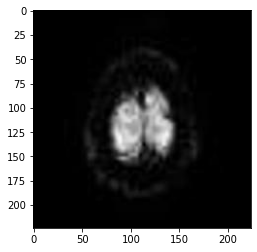

[[0.0000000e+00 9.9972743e-01 0.0000000e+00 0.0000000e+00 2.7253214e-04]]


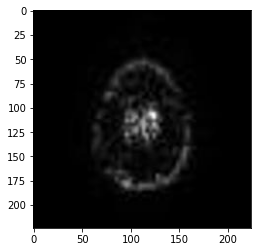

[[0. 1. 0. 0. 0.]]


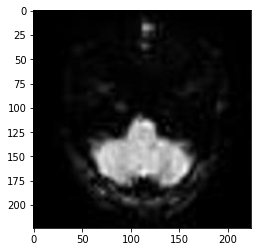

[[0. 1. 0. 0. 0.]]


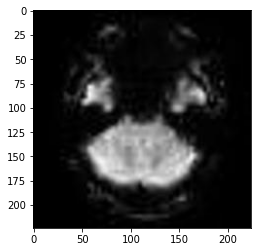

[[0. 0. 0. 1. 0.]]


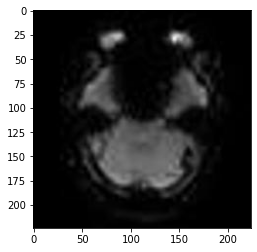

[[0. 1. 0. 0. 0.]]


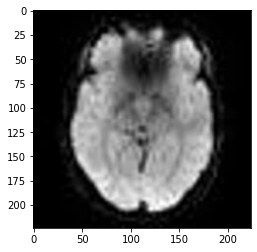

[[5.067171e-17 0.000000e+00 0.000000e+00 1.000000e+00 0.000000e+00]]


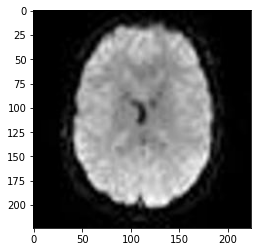

[[3.1590057e-22 0.0000000e+00 0.0000000e+00 5.9957336e-26 1.0000000e+00]]


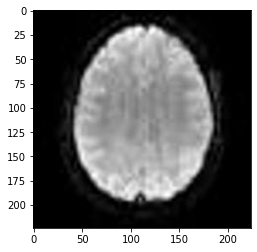

[[7.3348236e-16 0.0000000e+00 0.0000000e+00 1.0000000e+00 0.0000000e+00]]


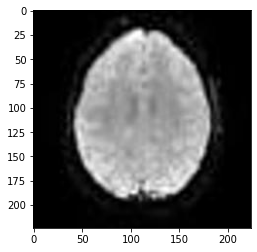

[[1. 0. 0. 0. 0.]]


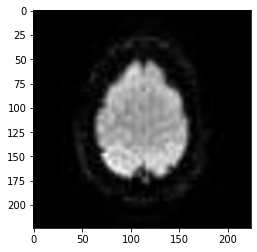

[[0.0000000e+00 1.0000000e+00 0.0000000e+00 0.0000000e+00 1.1995538e-15]]


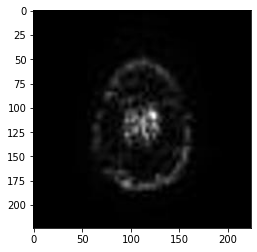

[[0. 1. 0. 0. 0.]]


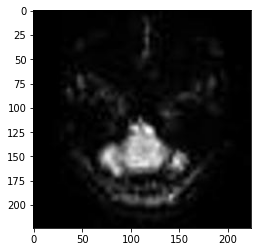

[[0. 1. 0. 0. 0.]]


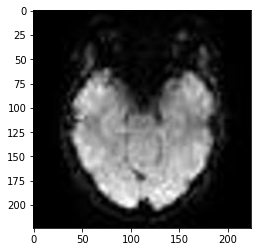

[[0.0000000e+00 1.0000000e+00 0.0000000e+00 7.0239216e-15 0.0000000e+00]]


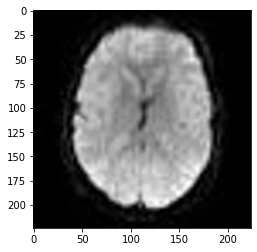

[[0. 0. 0. 1. 0.]]


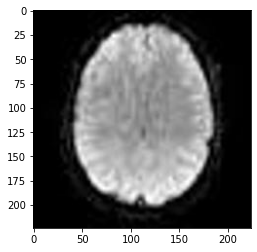

[[1.2360553e-24 2.6414052e-13 5.1361402e-03 9.9486381e-01 0.0000000e+00]]


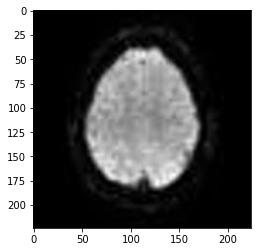

[[9.9997520e-01 2.4826675e-05 0.0000000e+00 9.8610424e-14 0.0000000e+00]]


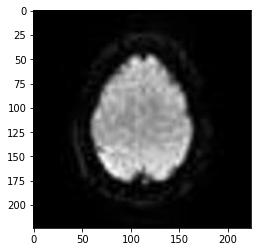

[[0. 1. 0. 0. 0.]]


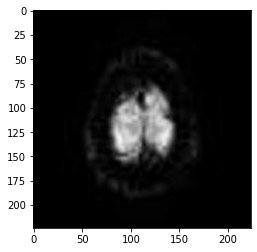

[[0. 1. 0. 0. 0.]]


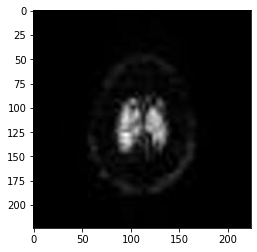

[[0.0000000e+00 1.0000000e+00 0.0000000e+00 0.0000000e+00 1.7978173e-10]]


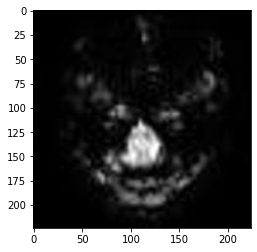

[[0. 1. 0. 0. 0.]]


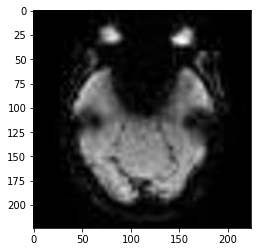

[[1. 0. 0. 0. 0.]]


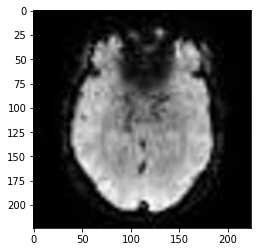

[[0. 0. 0. 1. 0.]]


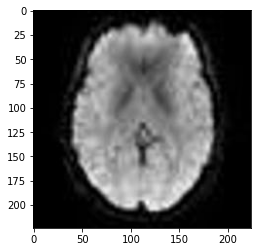

[[0. 0. 0. 1. 0.]]


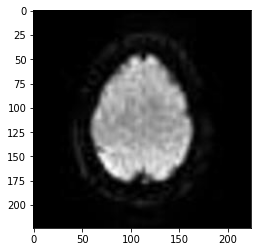

[[0.0000000e+00 1.0000000e+00 0.0000000e+00 0.0000000e+00 1.6033203e-37]]


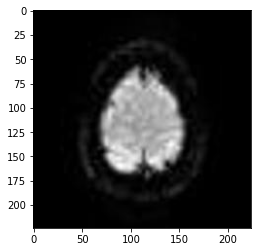

[[0. 1. 0. 0. 0.]]


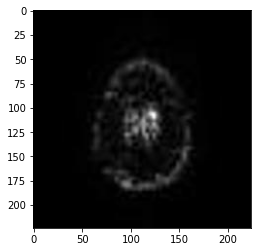

[[0. 1. 0. 0. 0.]]


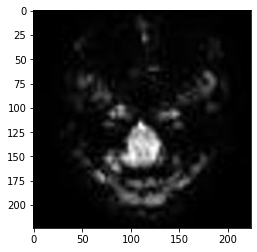

[[0. 1. 0. 0. 0.]]


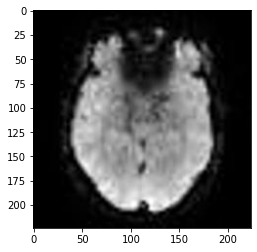

[[0. 0. 0. 1. 0.]]


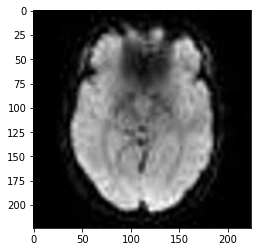

[[0.0000000e+00 1.0000000e+00 0.0000000e+00 3.8788922e-21 0.0000000e+00]]


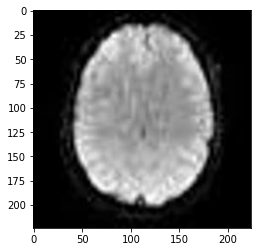

[[0. 0. 0. 1. 0.]]


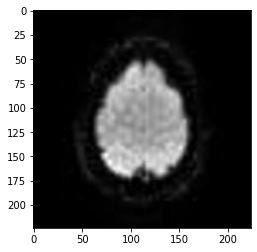

[[0. 1. 0. 0. 0.]]


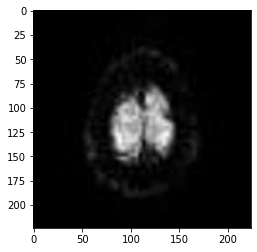

[[0. 1. 0. 0. 0.]]


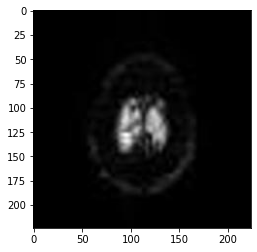

[[0. 1. 0. 0. 0.]]


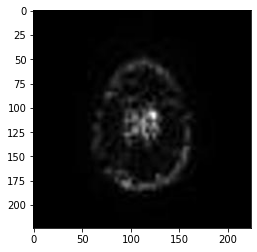

[[0. 1. 0. 0. 0.]]


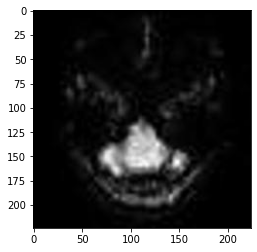

[[0. 1. 0. 0. 0.]]


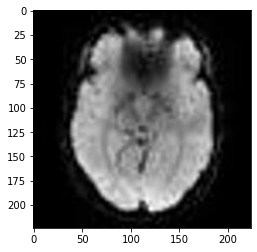

[[1.407809e-35 1.000000e+00 0.000000e+00 0.000000e+00 0.000000e+00]]


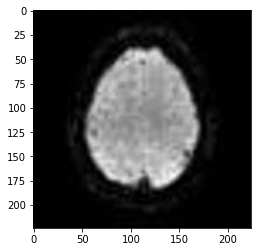

[[1.9483771e-21 4.6802643e-29 0.0000000e+00 1.0000000e+00 0.0000000e+00]]


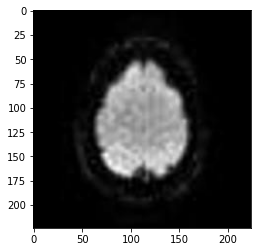

[[0. 1. 0. 0. 0.]]


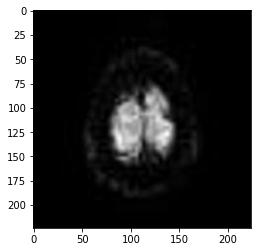

[[0. 1. 0. 0. 0.]]


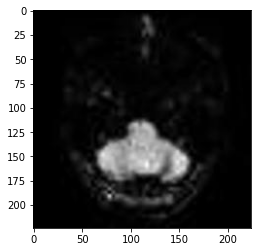

[[0. 1. 0. 0. 0.]]


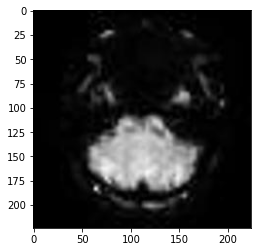

[[0. 1. 0. 0. 0.]]


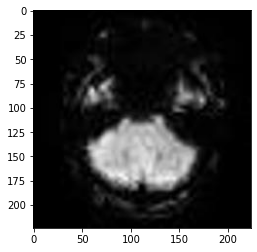

[[0. 0. 0. 1. 0.]]


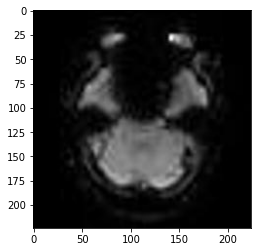

[[0.0000000e+00 9.9997866e-01 0.0000000e+00 2.1376221e-05 0.0000000e+00]]


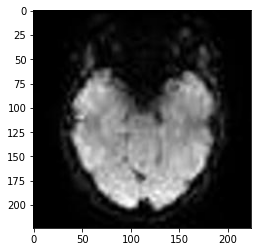

[[0.0000000e+00 3.3323563e-12 0.0000000e+00 1.0000000e+00 0.0000000e+00]]


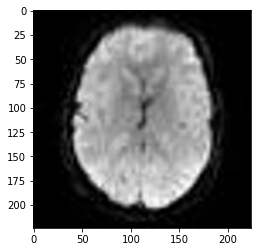

[[0.000000e+00 1.000000e+00 0.000000e+00 3.562983e-25 0.000000e+00]]


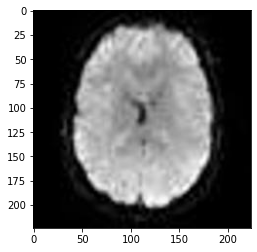

[[2.1010997e-26 1.8573912e-05 0.0000000e+00 9.9998140e-01 0.0000000e+00]]


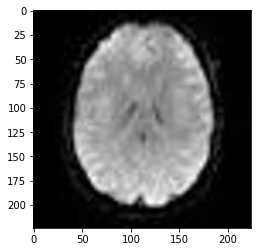

[[1.8162492e-33 3.6525904e-38 0.0000000e+00 1.0000000e+00 0.0000000e+00]]


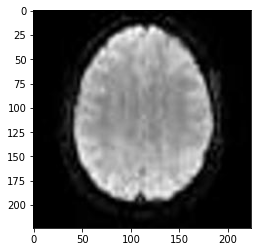

[[0. 0. 0. 1. 0.]]


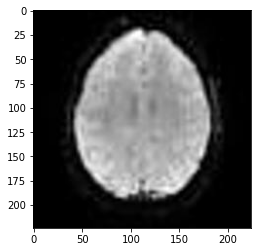

[[1. 0. 0. 0. 0.]]


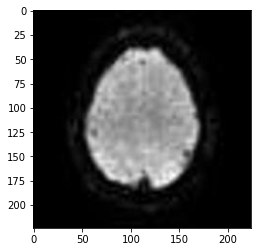

[[0.0000000e+00 1.0000000e+00 0.0000000e+00 1.5811876e-14 0.0000000e+00]]


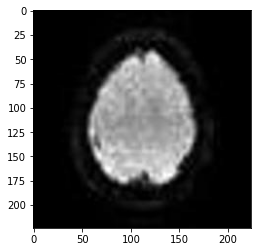

[[0.31704456 0.68295544 0.         0.         0.        ]]


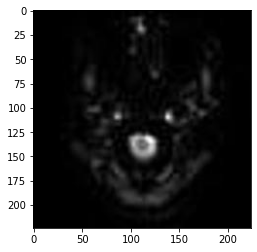

[[0. 0. 0. 1. 0.]]


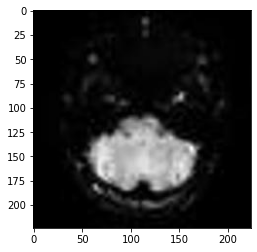

[[0. 1. 0. 0. 0.]]


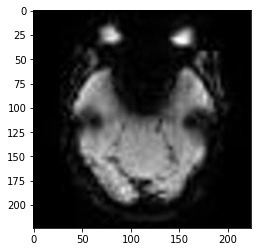

[[1. 0. 0. 0. 0.]]


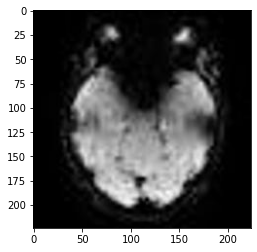

[[0.0000000e+00 1.3567838e-18 0.0000000e+00 1.0000000e+00 0.0000000e+00]]


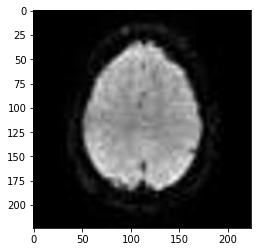

[[0. 1. 0. 0. 0.]]


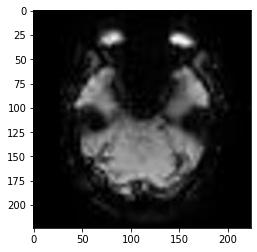

[[0. 0. 0. 1. 0.]]


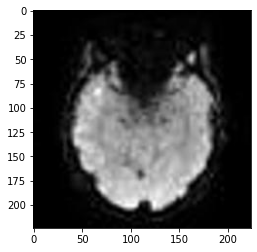

[[0. 0. 0. 1. 0.]]


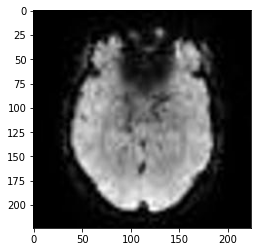

[[0.0000000e+00 5.9930918e-15 0.0000000e+00 1.0000000e+00 1.4762732e-26]]


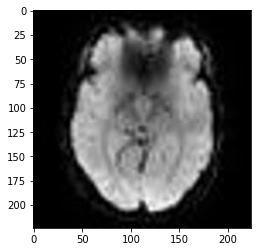

[[0.0000000e+00 1.0000000e+00 0.0000000e+00 1.5283155e-33 0.0000000e+00]]


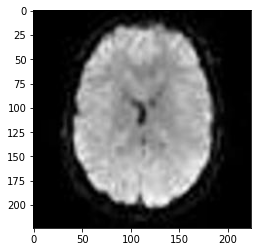

[[5.3017792e-20 1.0000000e+00 0.0000000e+00 8.6378170e-32 2.3187106e-37]]


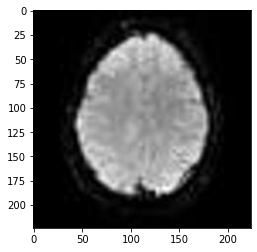

[[1. 0. 0. 0. 0.]]


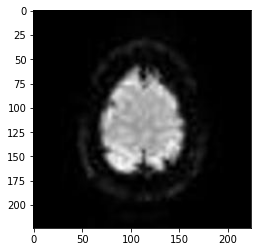

[[0. 1. 0. 0. 0.]]


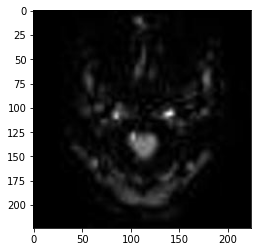

[[0.0000000e+00 1.4450667e-17 0.0000000e+00 1.0000000e+00 0.0000000e+00]]


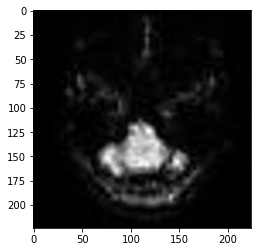

[[0. 1. 0. 0. 0.]]


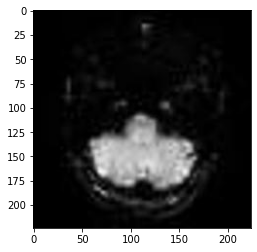

[[0. 1. 0. 0. 0.]]


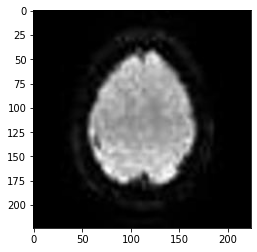

[[2.9799081e-22 1.0000000e+00 0.0000000e+00 0.0000000e+00 4.6700022e-32]]


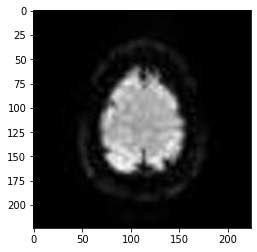

[[0. 1. 0. 0. 0.]]


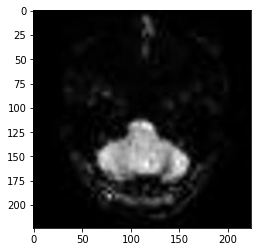

[[0. 1. 0. 0. 0.]]


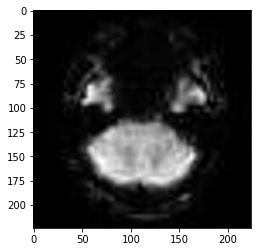

[[0. 0. 0. 1. 0.]]


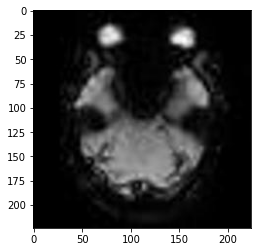

[[0. 1. 0. 0. 0.]]


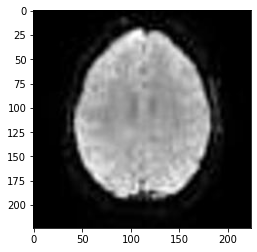

[[1. 0. 0. 0. 0.]]


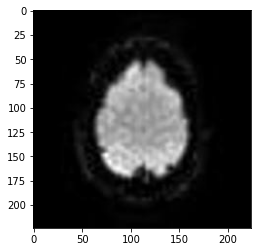

[[0. 1. 0. 0. 0.]]


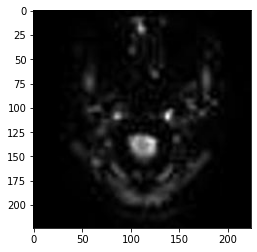

[[0.0000000e+00 2.3646288e-10 0.0000000e+00 1.0000000e+00 2.6140056e-23]]


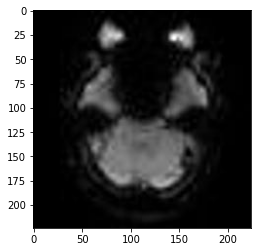

[[0. 1. 0. 0. 0.]]


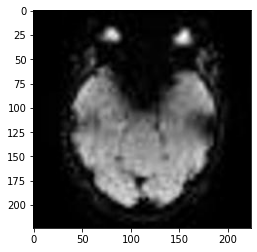

[[0. 0. 0. 1. 0.]]


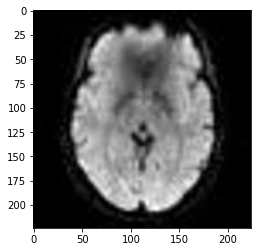

[[0.000000e+00 2.196585e-14 0.000000e+00 1.000000e+00 0.000000e+00]]


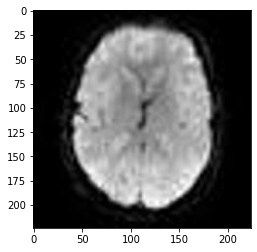

[[0.0000000e+00 9.9974090e-01 0.0000000e+00 2.5907328e-04 4.0866583e-13]]


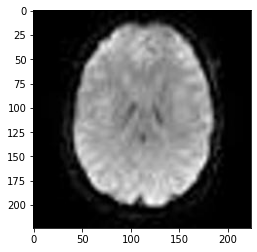

[[9.9999475e-01 2.3663701e-15 0.0000000e+00 5.2849286e-06 0.0000000e+00]]


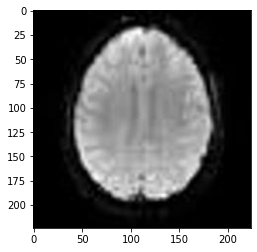

[[9.999993e-01 7.002703e-07 0.000000e+00 0.000000e+00 0.000000e+00]]


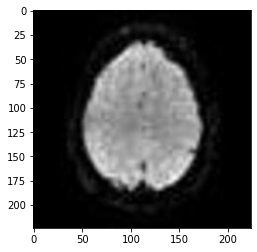

[[0. 1. 0. 0. 0.]]


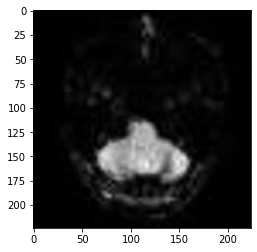

[[3.7786741e-36 1.8013774e-13 0.0000000e+00 1.0000000e+00 0.0000000e+00]]


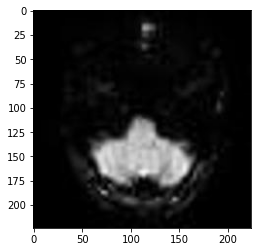

[[0. 1. 0. 0. 0.]]


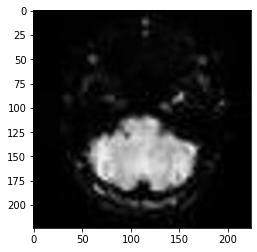

[[0. 1. 0. 0. 0.]]


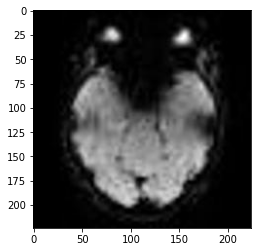

[[0. 0. 0. 1. 0.]]


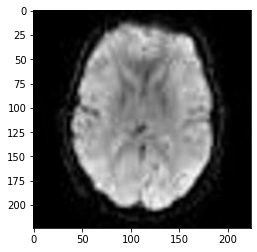

[[0. 0. 0. 1. 0.]]


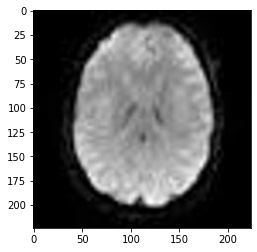

[[7.1557016e-10 9.8786540e-27 0.0000000e+00 1.0000000e+00 0.0000000e+00]]


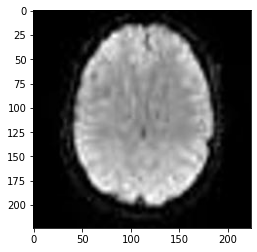

[[0. 0. 0. 1. 0.]]


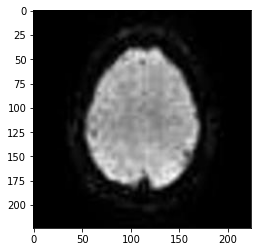

[[1.3345485e-08 4.4774854e-30 0.0000000e+00 1.0000000e+00 0.0000000e+00]]


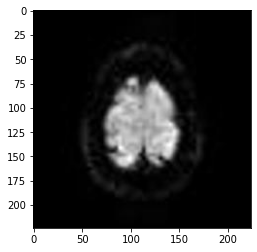

[[0.000000e+00 9.919861e-18 0.000000e+00 0.000000e+00 1.000000e+00]]


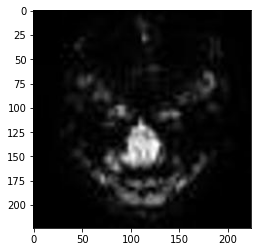

[[0. 1. 0. 0. 0.]]


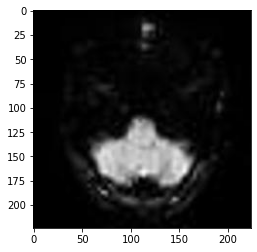

[[0. 1. 0. 0. 0.]]


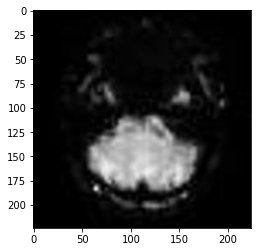

[[0.000000e+00 1.000000e+00 0.000000e+00 2.292514e-26 0.000000e+00]]


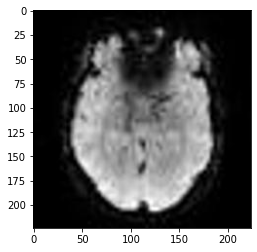

[[0.000000e+00 0.000000e+00 9.896651e-11 1.000000e+00 0.000000e+00]]


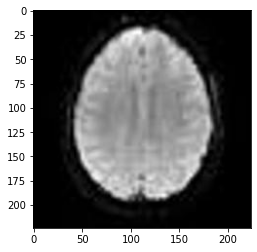

[[1. 0. 0. 0. 0.]]


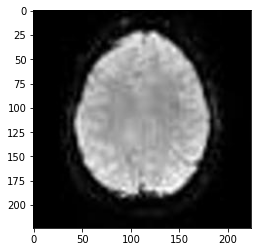

[[1. 0. 0. 0. 0.]]


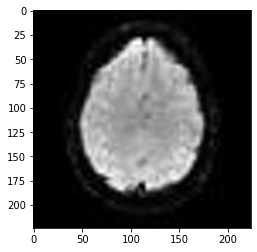

[[1.0000000e+00 4.0451882e-18 0.0000000e+00 0.0000000e+00 0.0000000e+00]]


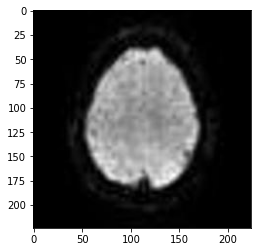

[[9.9999988e-01 2.3773925e-16 0.0000000e+00 6.5001913e-08 0.0000000e+00]]


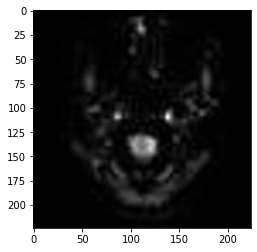

[[0.0000000e+00 4.7700064e-22 0.0000000e+00 1.0000000e+00 0.0000000e+00]]


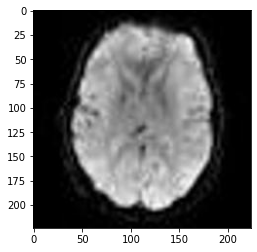

[[0. 0. 0. 1. 0.]]


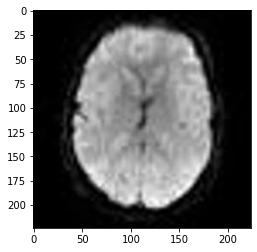

[[0.0000000e+00 1.0000000e+00 0.0000000e+00 3.0643005e-08 0.0000000e+00]]


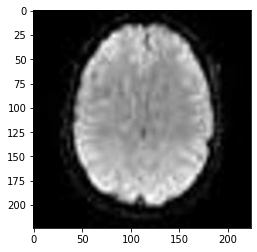

[[0.0000000e+00 0.0000000e+00 1.1168541e-22 1.0000000e+00 0.0000000e+00]]


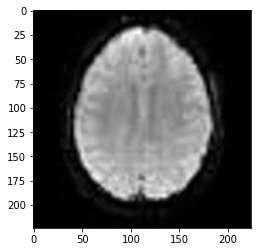

[[1.000000e+00 0.000000e+00 0.000000e+00 5.850406e-28 3.104700e-27]]


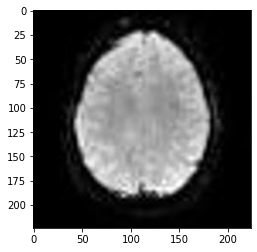

[[1. 0. 0. 0. 0.]]


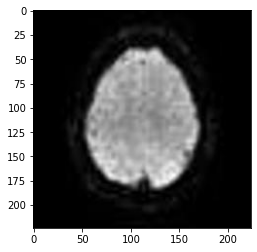

[[6.7248521e-14 1.4964124e-26 0.0000000e+00 1.0000000e+00 0.0000000e+00]]


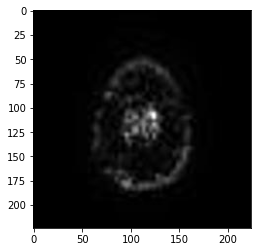

[[0. 1. 0. 0. 0.]]


In [ ]:
dir_path='/content/gdrive/MyDrive/Dataset Split/Dataset Distribution/Test/Binswanger Dementia'

for a in os.listdir(dir_path):
    imge=image.load_img(dir_path+'/'+a,target_size=(224,224))
    plt.imshow(imge)
    plt.show()
    X=image.img_to_array(imge)
    X=np.expand_dims(X,axis=0)
    images=np.vstack([X])
    val =model.predict(images)

    print(val)